In [ ]:
!python -m pip install pyyaml>=5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities (e.g. compiled operators).
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Cloning into 'detectron2'...
remote: Enumerating objects: 15800, done.
remote: Counting objects: 100% (57/57), done.
remote: Compressing objects: 100% (44/44), done.
remote: Total 15800 (delta 20), reused 37 (delta 13), pack-reused 15743 (from 1)
Receiving objects: 100% (15800/15800), 6.37 MiB | 8.46 MiB/s, done.
Resolving deltas: 100% (11516/11516), done.
Ignoring dataclasses: markers 'python_version < "3.7"' don't match your environment
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 4.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.2/79.2 kB 6.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 12.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 15.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 67.3 MB/s eta 0:00

In [ ]:
import detectron2
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
import cv2
import matplotlib.pyplot as plt


In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2023 NVIDIA Corporation
Built on Tue_Aug_15_22:02:13_PDT_2023
Cuda compilation tools, release 12.2, V12.2.140
Build cuda_12.2.r12.2/compiler.33191640_0
torch:  2.5 ; cuda:  cu121
detectron2: 0.6


In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [ ]:
#cargar drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# **LOS DATOS**

Se tienen 5 carpetas, una por cada planta. Albahaca, hinojo, malva, rucula, tomillo. Cada carpeta con 200 img que tienen sus anotaciones en el archivo hojas_final_ann.json que estan en formato COCO

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


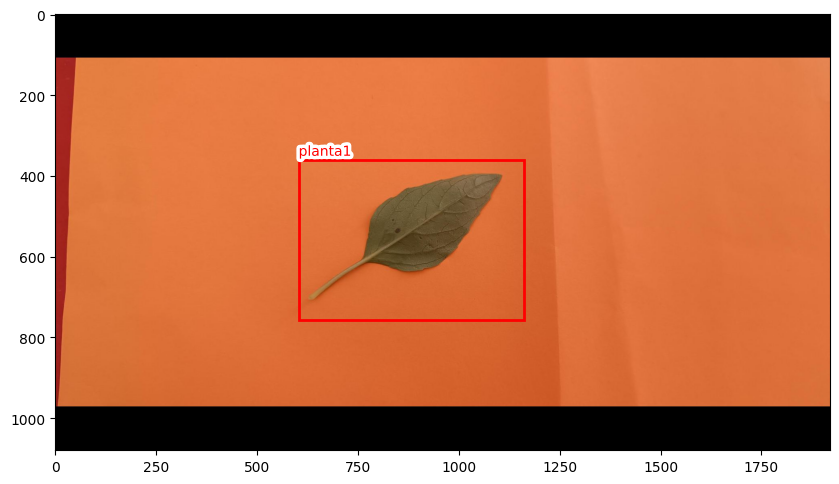

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import matplotlib.patheffects as PathEffects
import random
from pycocotools.coco import COCO
from PIL import Image
import os

# Rutas de las imágenes y anotaciones
img_dir = '/drive/MyDrive/INTELIGENCIA_ARTIFICIAL_SIS421/prueba'
ann_file = '/content/drive/MyDrive/INTELIGENCIA_ARTIFICIAL_SIS421/prueba/annotations.json'

# Cargar el archivo de anotaciones en formato COCO
coco = COCO(ann_file)

# Obtener las categorías y clases
cats = coco.loadCats(coco.getCatIds())
classes = [cat['name'] for cat in cats]

# Función para obtener una imagen y sus anotaciones a partir de su índice
def get_sample(ix):
    img_id = coco.getImgIds()[ix]
    img_info = coco.loadImgs(img_id)[0]

    # Usar barras diagonales en lugar de barras inversas para compatibilidad con Linux
    img_path = '/content/drive/MyDrive/INTELIGENCIA_ARTIFICIAL_SIS421/prueba/planta1/Albahaca_1.jpg'
    img = Image.open(img_path).convert('RGB')
    img_np = np.array(img)

    ann_ids = coco.getAnnIds(imgIds=img_id)
    anns = coco.loadAnns(ann_ids)
    labels = np.array([classes.index(coco.loadCats(ann['category_id'])[0]['name']) for ann in anns])
    bbs = np.array([[ann['bbox'][0], ann['bbox'][1], ann['bbox'][2], ann['bbox'][3]] for ann in anns])

    return img_np, (labels, bbs)

# Función para mostrar las imágenes con sus anotaciones
def plot_anns(img, anns, ax=None, bg=-1):
    if not ax:
        fig, ax = plt.subplots(figsize=(10, 6))
    ax.imshow(img)
    labels, bbs = anns
    for lab, bb in zip(labels, bbs):
        if bg == -1 or lab != bg:
            x, y, w, h = bb
            rect = mpatches.Rectangle((x, y), w, h, fill=False, edgecolor='red', linewidth=2)
            text = ax.text(x, y - 10, classes[lab], {'color': 'red'})
            text.set_path_effects([PathEffects.withStroke(linewidth=5, foreground='w')])
            ax.add_patch(rect)

# Ejemplo de uso
img_np, anns = get_sample(0)  # Puedes probar con otros índices
plot_anns(img_np, anns)
plt.show()


In [35]:
import albumentations as A

# Función para crear una composición de transformaciones con una lista de augmentations
def get_aug(aug, min_area=0., min_visibility=0.):
    return A.Compose(aug, bbox_params={'format': 'coco', 'min_area': min_area, 'min_visibility': min_visibility, 'label_fields': ['labels']})

# Lista completa de transformaciones combinadas con resize
transformations = {
    "resize": get_aug([A.Resize(224, 224)]),
    "resize_blur": get_aug([A.Resize(224, 224), A.Blur(blur_limit=(3, 7))]),
    "resize_advanced_blur": get_aug([A.Resize(224, 224), A.RandomRotate90(p=0.5)]),
    "resize_gaussian_blur": get_aug([A.Resize(224, 224),A.HorizontalFlip(p=0.5)]),
    "resize_glass_blur": get_aug([A.Resize(224, 224), A.GlassBlur(sigma=0.5, max_delta=4)]),
    "resize_motion_blur": get_aug([A.Resize(224, 224), A.MotionBlur(blur_limit=(3, 7))]),
    "resize_median_blur": get_aug([A.Resize(224, 224), A.MedianBlur(blur_limit=7)]),
    "resize_zoom_blur": get_aug([A.Resize(224, 224), A.ZoomBlur()]),
    "resize_clahe": get_aug([A.Resize(224, 224), A.CLAHE()]),
    "resize_channel_dropout": get_aug([A.Resize(224, 224), A.ChannelDropout(p=1.0)]),
    "resize_channel_shuffle": get_aug([A.Resize(224, 224), A.ChannelShuffle(p=1.0)]),
    "resize_color_jitter": get_aug([A.Resize(224, 224), A.ColorJitter()]),
    "resize_defocus": get_aug([A.Resize(224, 224), A.Defocus()]),
    "resize_downscale": get_aug([A.Resize(224, 224), A.Downscale(scale_min=0.5, scale_max=0.9)]),
    "resize_emboss": get_aug([A.Resize(224, 224), A.Emboss()]),
    "resize_equalize": get_aug([A.Resize(224, 224), A.Equalize()]),
    "resize_fancy_pca": get_aug([A.Resize(224, 224), A.FancyPCA()]),
    "resize_gauss_noise": get_aug([A.Resize(224, 224), A.GaussNoise()]),
    "resize_iso_noise": get_aug([A.Resize(224, 224), A.ISONoise()]),
    "resize_multiplicative_noise": get_aug([A.Resize(224, 224), A.MultiplicativeNoise(multiplier=(0.9, 1.1))]),
    "resize_hue_saturation": get_aug([A.Resize(224, 224), A.HueSaturationValue()]),
    "resize_image_compression": get_aug([A.Resize(224, 224), A.ImageCompression(quality_lower=30, quality_upper=70)]),
    "resize_invert_img": get_aug([A.Resize(224, 224), A.InvertImg()]),
    "resize_normalize": get_aug([A.Resize(224, 224), A.Normalize()]),
    "resize_posterize": get_aug([A.Resize(224, 224), A.Posterize()]),
    "resize_rgb_shift": get_aug([A.Resize(224, 224), A.RGBShift()]),
    "resize_brightness_contrast": get_aug([A.Resize(224, 224), A.RandomBrightnessContrast()]),
    "resize_random_fog": get_aug([A.Resize(224, 224), A.RandomFog()]),
    "resize_random_gravel": get_aug([A.Resize(224, 224), A.RandomGravel()]),
    "resize_random_rain": get_aug([A.Resize(224, 224), A.RandomRain()]),
    "resize_random_shadow": get_aug([A.Resize(224, 224), A.RandomShadow()]),
    "resize_random_snow": get_aug([A.Resize(224, 224), A.RandomSnow()]),
    "resize_random_sun_flare": get_aug([A.Resize(224, 224), A.RandomSunFlare()]),
    "resize_random_gamma": get_aug([A.Resize(224, 224), A.RandomGamma()]),
    "resize_random_tone_curve": get_aug([A.Resize(224, 224), A.RandomToneCurve()]),
    "resize_sharpen": get_aug([A.Resize(224, 224), A.Sharpen()]),
    "resize_unsharp_mask": get_aug([A.Resize(224, 224), A.UnsharpMask()]),
    "resize_solarize": get_aug([A.Resize(224, 224), A.Solarize()]),
    "resize_spatter": get_aug([A.Resize(224, 224), A.Spatter()]),
    "resize_superpixels": get_aug([A.Resize(224, 224), A.Superpixels()]),
    "resize_to_float": get_aug([A.Resize(224, 224), A.ToFloat()]),
    "resize_to_gray": get_aug([A.Resize(224, 224), A.ToGray()]),
    "resize_to_rgb": get_aug([A.Resize(224, 224), A.ToRGB()]),
    "resize_to_sepia": get_aug([A.Resize(224, 224), A.ToSepia()]),
    "resize_ring_overshoot": get_aug([A.Resize(224, 224), A.RingingOvershoot()]),
    "resize_planckian_jitter": get_aug([A.Resize(224, 224), A.PlanckianJitter()])
}

# Aplicamos cada transformación y almacenamos los resultados
results = {}
labels, bbs = anns  # Suponiendo que anns contiene etiquetas y cajas

for name, transform in transformations.items():
    # Aplicar la transformación a la imagen, cajas y etiquetas
    augmented = transform(image=img_np, bboxes=bbs, labels=labels)
    # Guardar los resultados en el diccionario con el nombre de la transformación como clave
    results[name] = {
        "image": augmented['image'],
        "bboxes": augmented['bboxes'],
        "labels": augmented['labels']
    }

# Ejemplo de acceso a los resultados
for name, result in results.items():
    print(f"Resultados de la transformación '{name}':")
    print("Imagen shape:", result["image"].shape)
    print("Cajas:", result["bboxes"])
    print("Etiquetas:", result["labels"])


Resultados de la transformación 'resize':
Imagen shape: (224, 224, 3)
Cajas: [[70.39328 74.64325 65.03225 82.21361]]
Etiquetas: [0]
Resultados de la transformación 'resize_blur':
Imagen shape: (224, 224, 3)
Cajas: [[70.39328 74.64325 65.03225 82.21361]]
Etiquetas: [0]
Resultados de la transformación 'resize_advanced_blur':
Imagen shape: (224, 224, 3)
Cajas: [[70.39328 74.64325 65.03225 82.21361]]
Etiquetas: [0]
Resultados de la transformación 'resize_gaussian_blur':
Imagen shape: (224, 224, 3)
Cajas: [[88.57447 74.64325 65.03225 82.21361]]
Etiquetas: [0]
Resultados de la transformación 'resize_glass_blur':
Imagen shape: (224, 224, 3)
Cajas: [[70.39328 74.64325 65.03225 82.21361]]
Etiquetas: [0]
Resultados de la transformación 'resize_motion_blur':
Imagen shape: (224, 224, 3)
Cajas: [[70.39328 74.64325 65.03225 82.21361]]
Etiquetas: [0]
Resultados de la transformación 'resize_median_blur':
Imagen shape: (224, 224, 3)
Cajas: [[70.39328 74.64325 65.03225 82.21361]]
Etiquetas: [0]
Resultad

Mostrando resultado de la transformación 'resize':


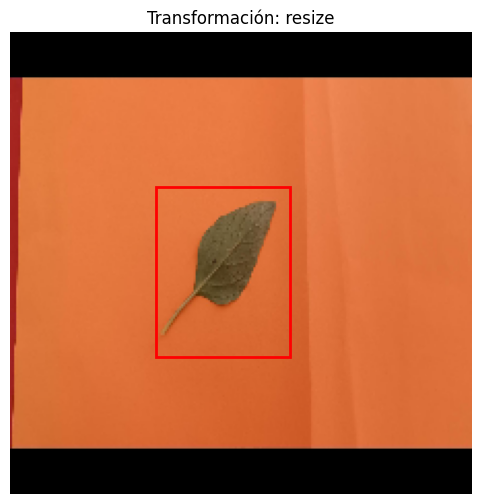

Mostrando resultado de la transformación 'resize_blur':


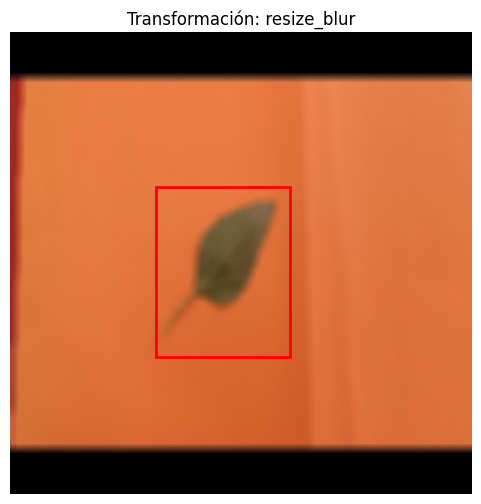

Mostrando resultado de la transformación 'resize_advanced_blur':


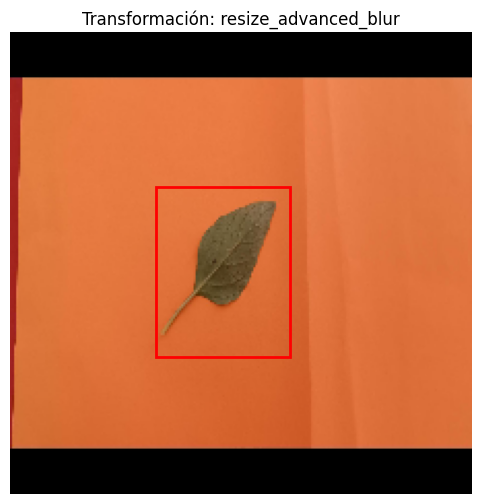

Mostrando resultado de la transformación 'resize_gaussian_blur':


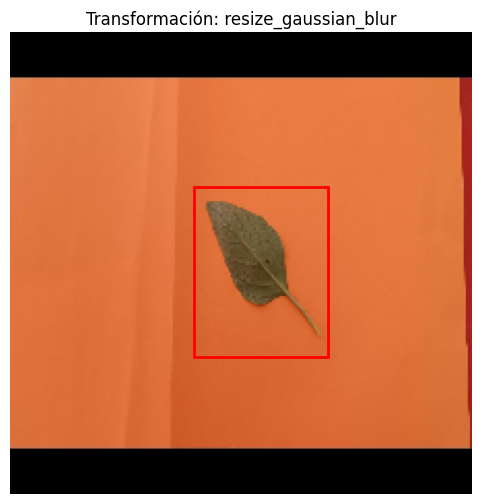

Mostrando resultado de la transformación 'resize_glass_blur':


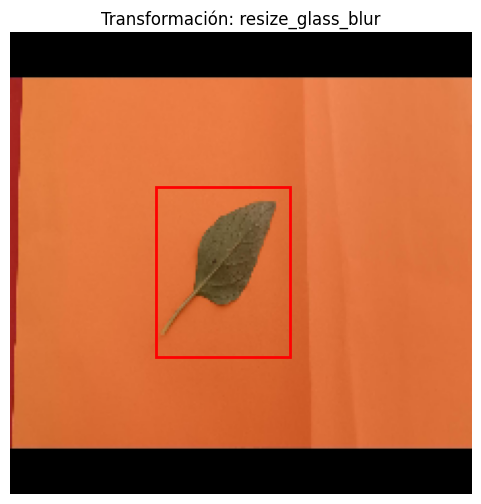

Mostrando resultado de la transformación 'resize_motion_blur':


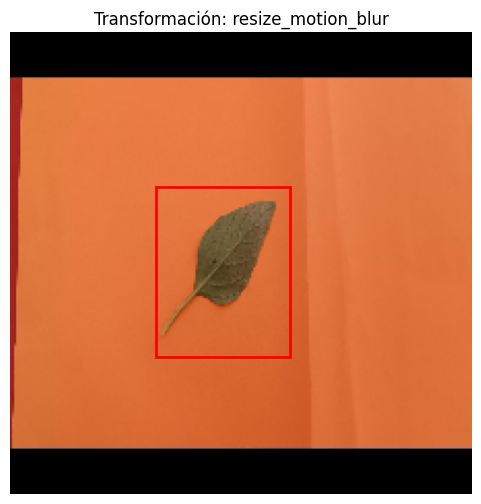

Mostrando resultado de la transformación 'resize_median_blur':


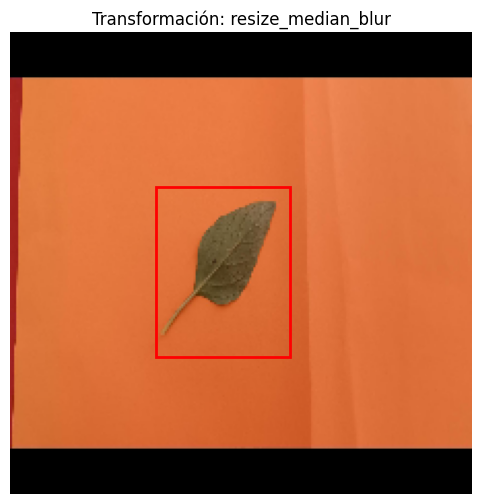

Mostrando resultado de la transformación 'resize_zoom_blur':


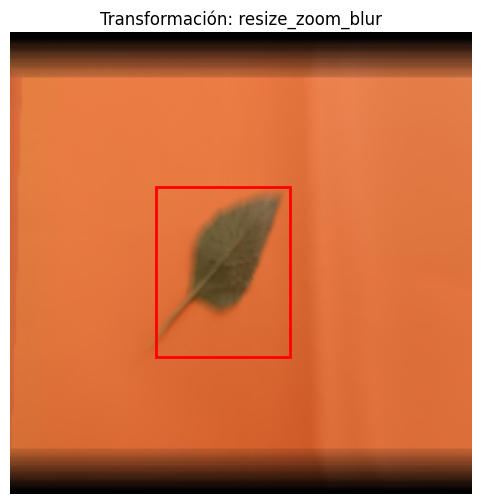

Mostrando resultado de la transformación 'resize_clahe':


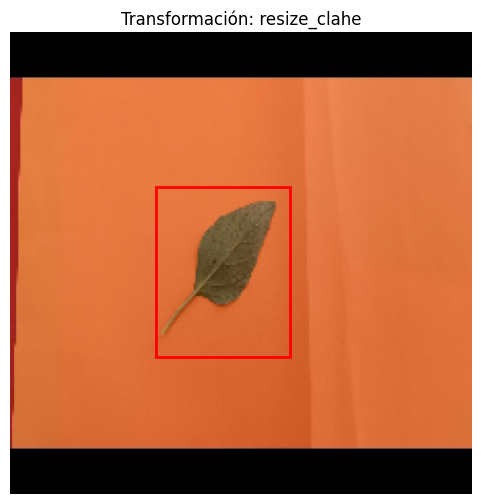

Mostrando resultado de la transformación 'resize_channel_dropout':


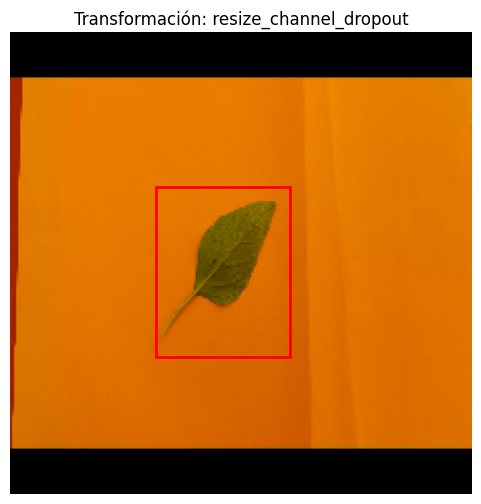

Mostrando resultado de la transformación 'resize_channel_shuffle':


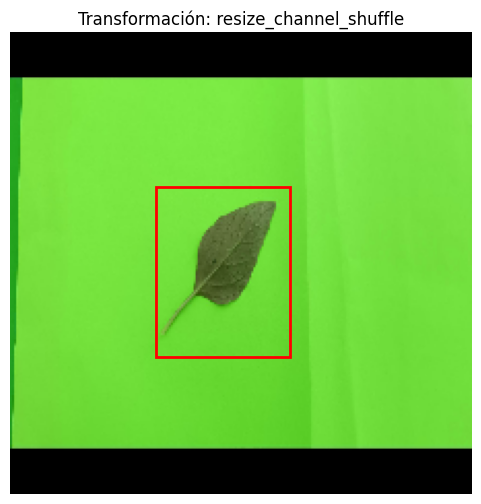

Mostrando resultado de la transformación 'resize_color_jitter':


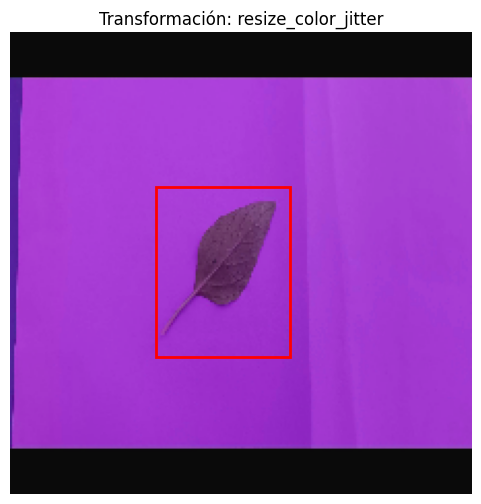

Mostrando resultado de la transformación 'resize_defocus':


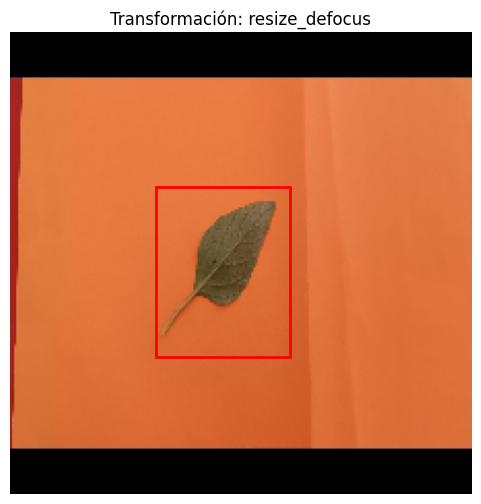

Mostrando resultado de la transformación 'resize_downscale':


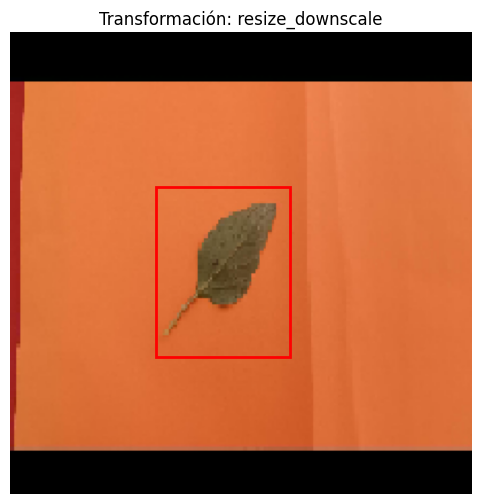

Mostrando resultado de la transformación 'resize_emboss':


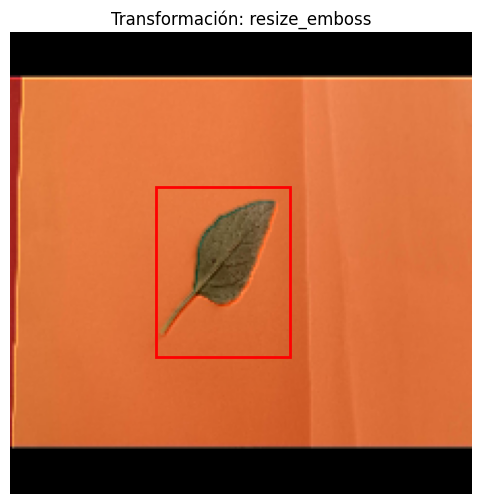

Mostrando resultado de la transformación 'resize_equalize':


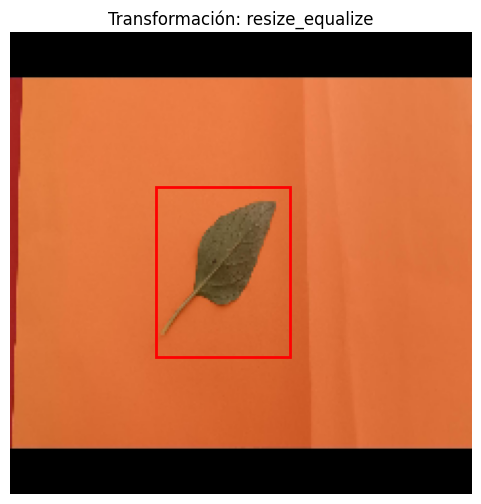

Mostrando resultado de la transformación 'resize_fancy_pca':


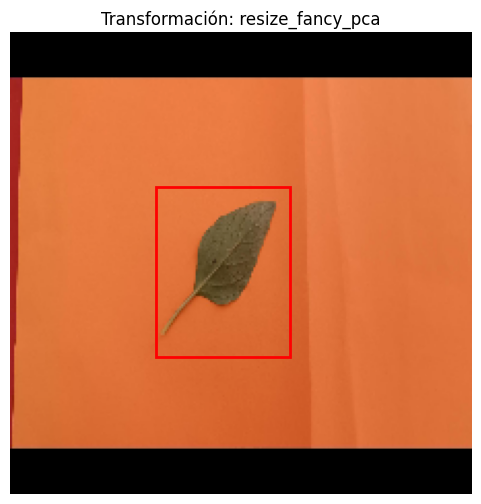

Mostrando resultado de la transformación 'resize_gauss_noise':


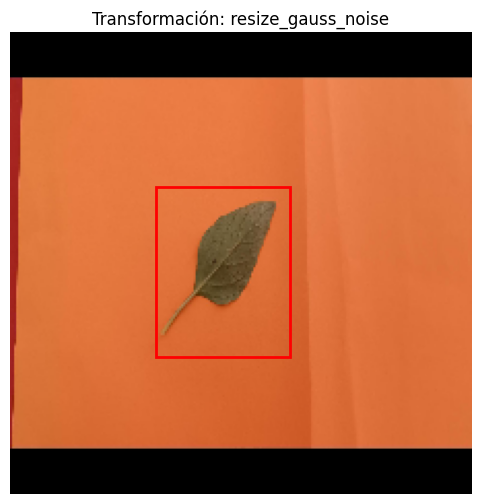

Mostrando resultado de la transformación 'resize_iso_noise':


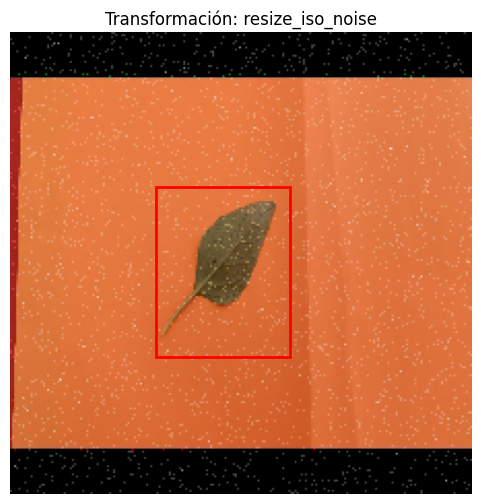

Mostrando resultado de la transformación 'resize_multiplicative_noise':


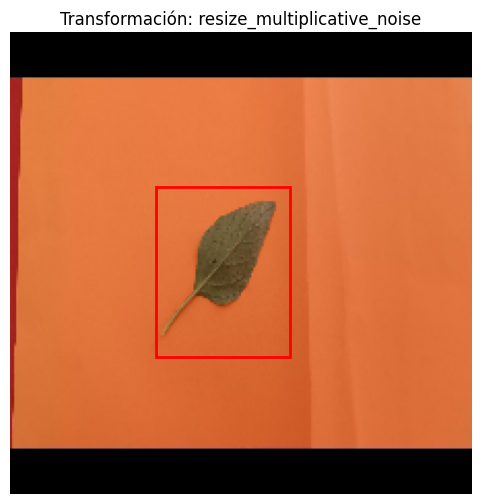

Mostrando resultado de la transformación 'resize_hue_saturation':


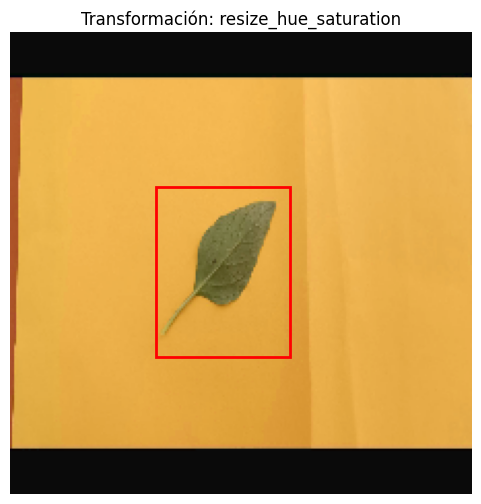

Mostrando resultado de la transformación 'resize_image_compression':


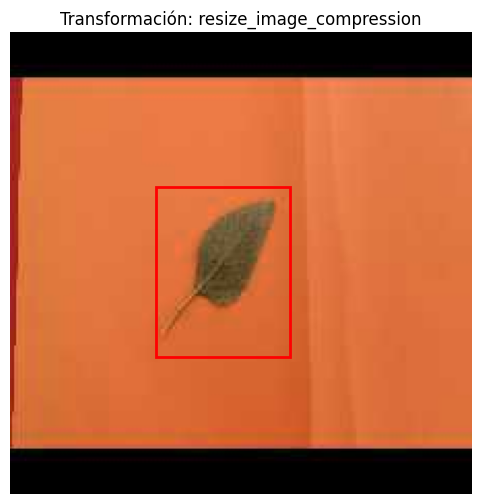

Mostrando resultado de la transformación 'resize_invert_img':


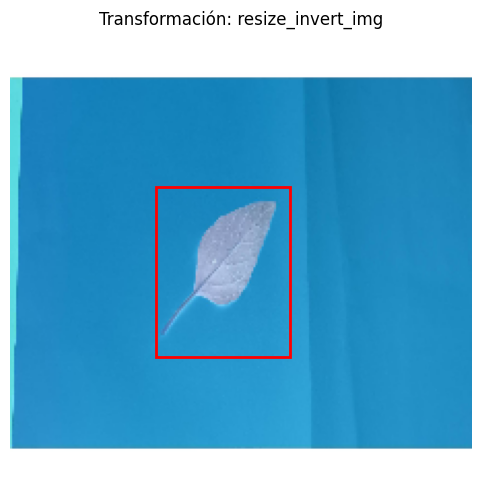

Mostrando resultado de la transformación 'resize_normalize':


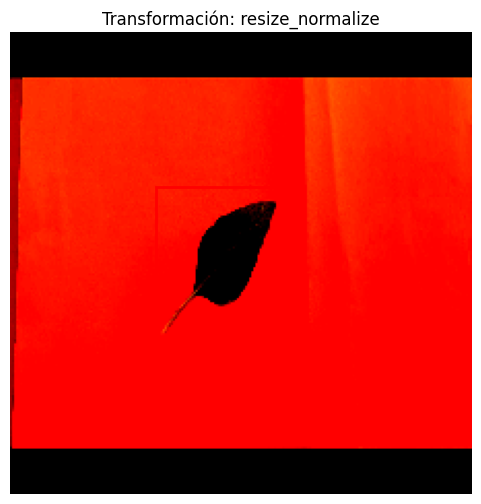

Mostrando resultado de la transformación 'resize_posterize':


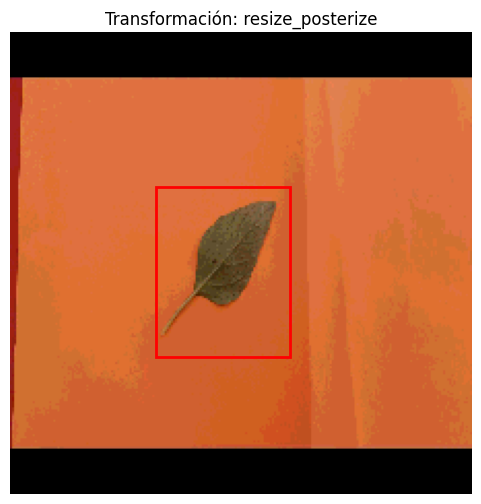

Mostrando resultado de la transformación 'resize_rgb_shift':


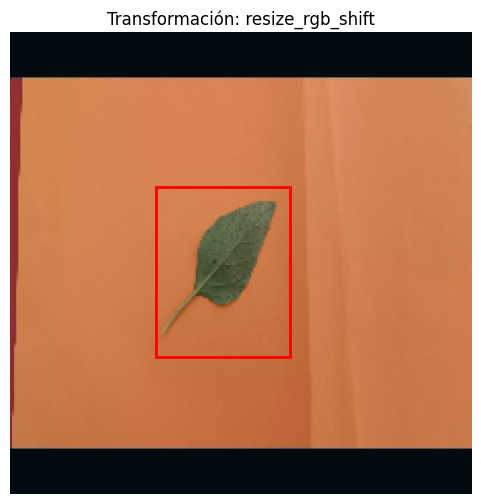

Mostrando resultado de la transformación 'resize_brightness_contrast':


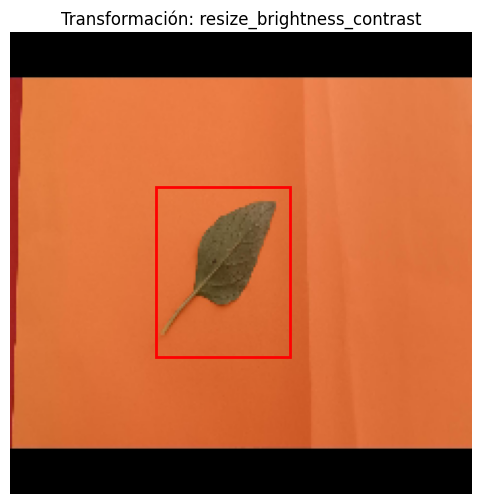

Mostrando resultado de la transformación 'resize_random_fog':


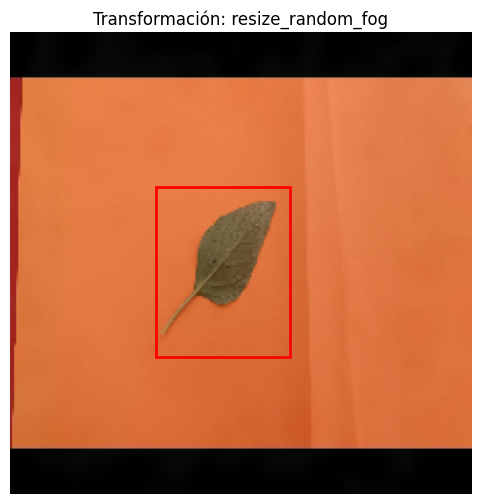

Mostrando resultado de la transformación 'resize_random_gravel':


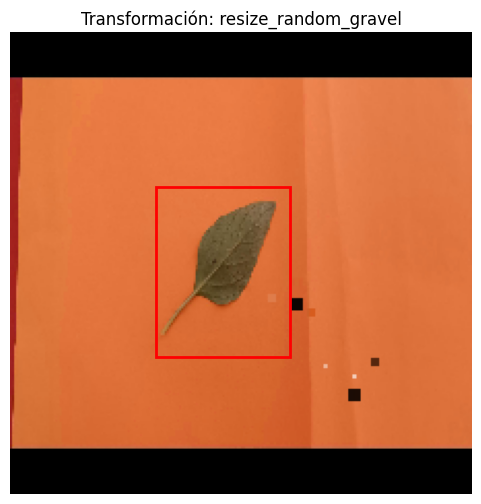

Mostrando resultado de la transformación 'resize_random_rain':


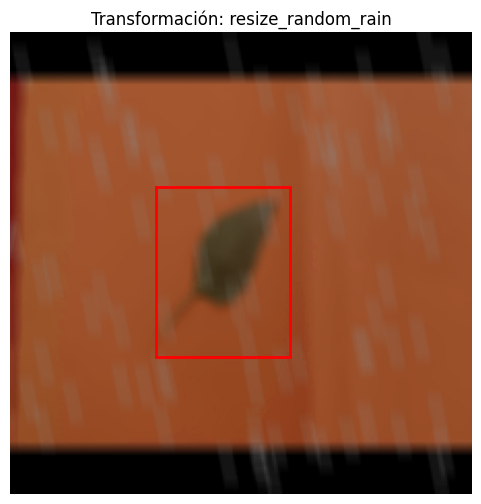

Mostrando resultado de la transformación 'resize_random_shadow':


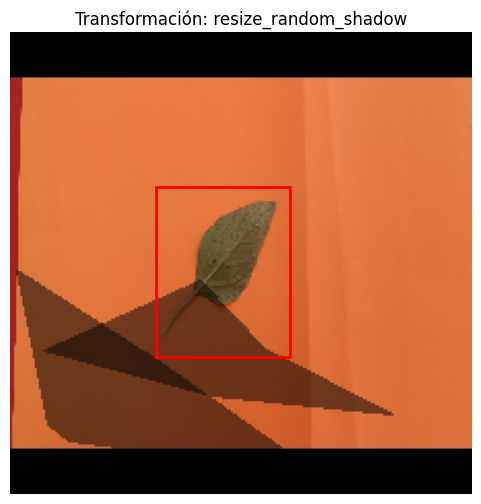

Mostrando resultado de la transformación 'resize_random_snow':


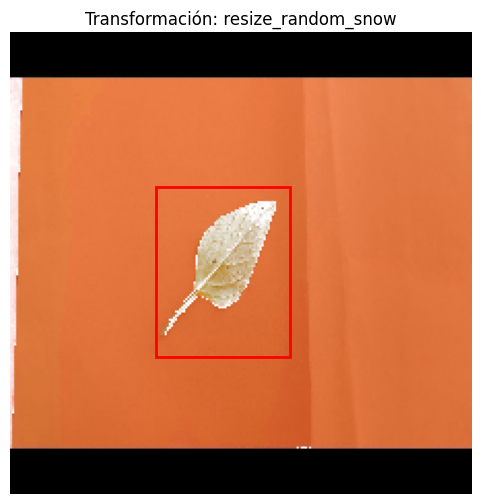

Mostrando resultado de la transformación 'resize_random_sun_flare':


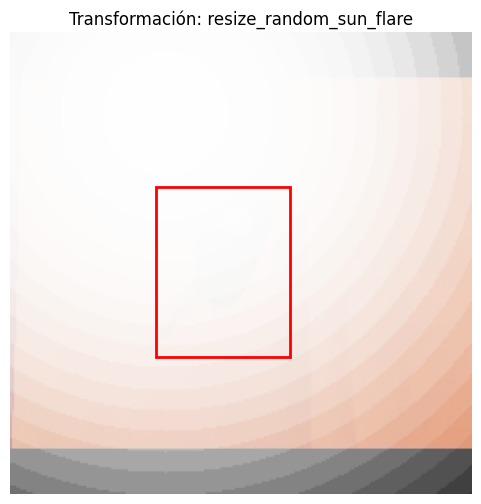

Mostrando resultado de la transformación 'resize_random_gamma':


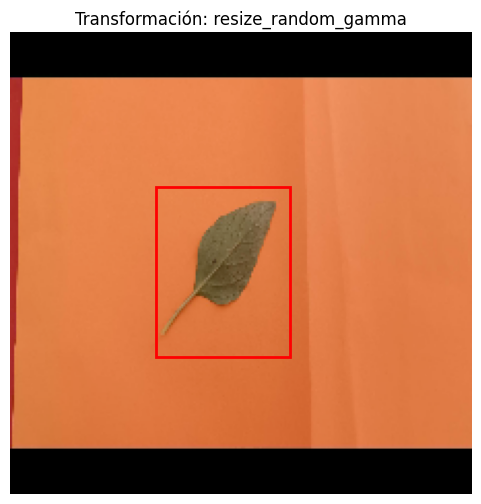

Mostrando resultado de la transformación 'resize_random_tone_curve':


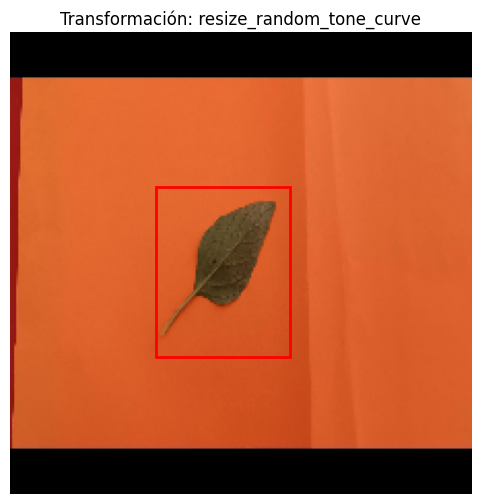

Mostrando resultado de la transformación 'resize_sharpen':


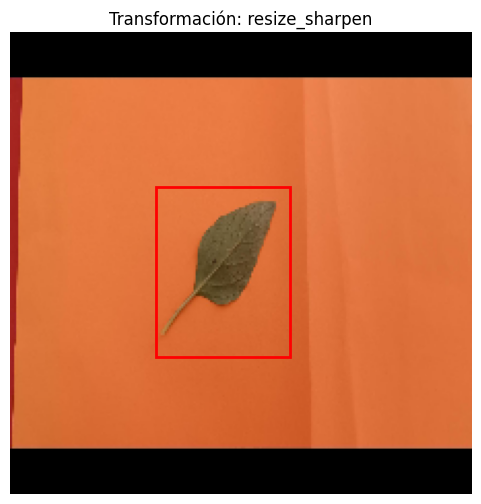

Mostrando resultado de la transformación 'resize_unsharp_mask':


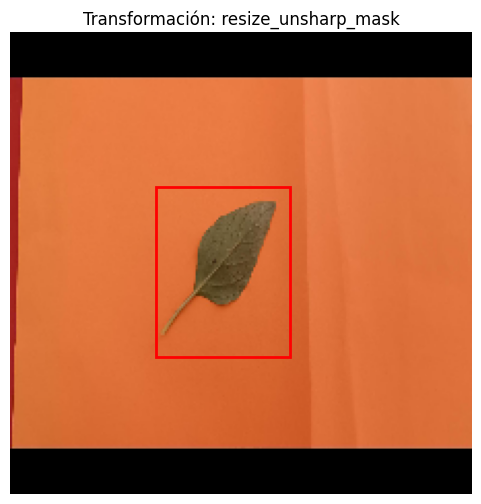

Mostrando resultado de la transformación 'resize_solarize':


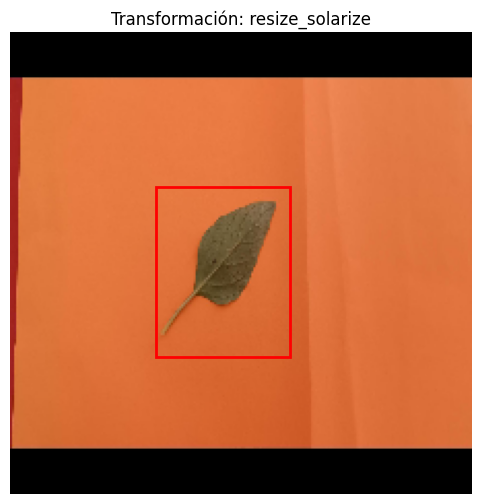

Mostrando resultado de la transformación 'resize_spatter':


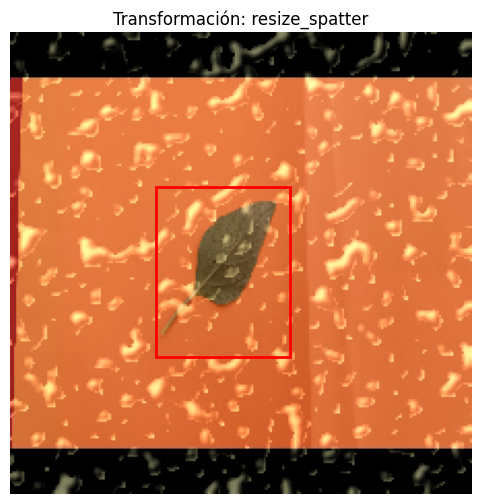

Mostrando resultado de la transformación 'resize_superpixels':


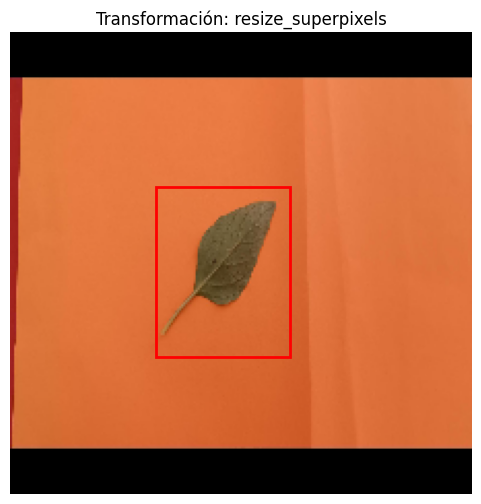

Mostrando resultado de la transformación 'resize_to_float':


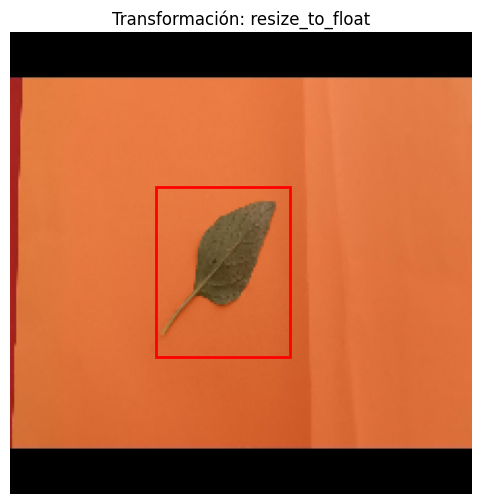

Mostrando resultado de la transformación 'resize_to_gray':


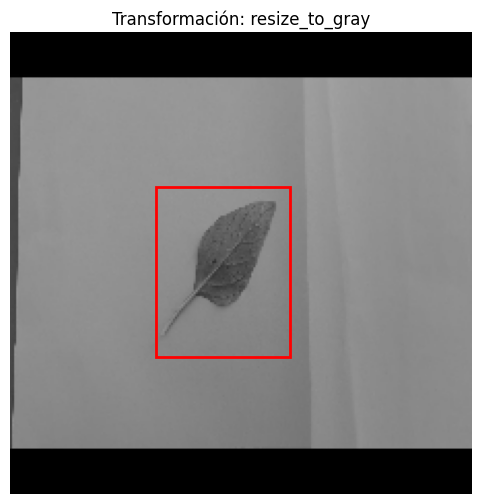

Mostrando resultado de la transformación 'resize_to_rgb':


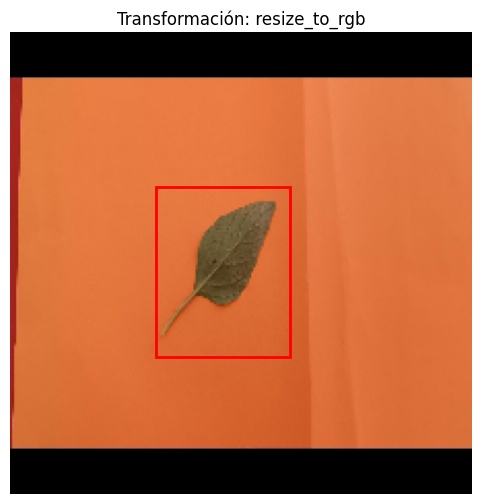

Mostrando resultado de la transformación 'resize_to_sepia':


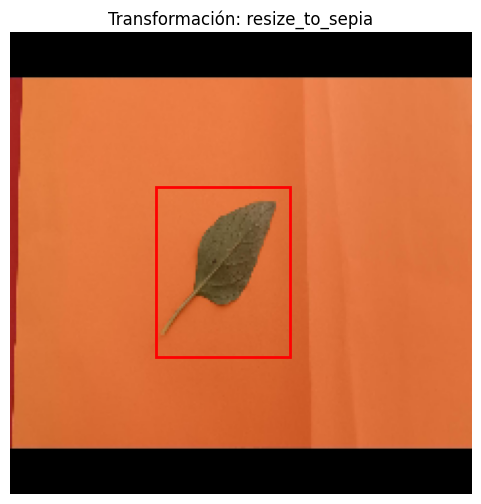

Mostrando resultado de la transformación 'resize_ring_overshoot':


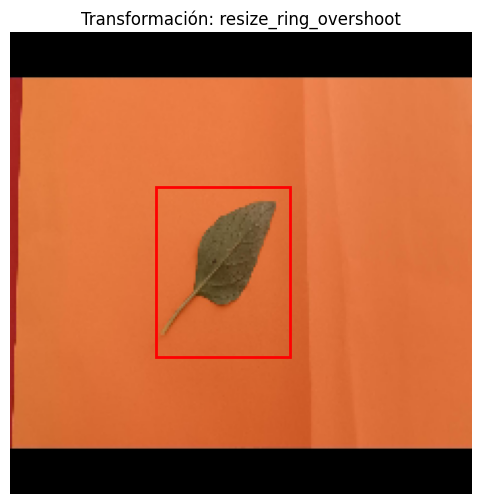

Mostrando resultado de la transformación 'resize_planckian_jitter':


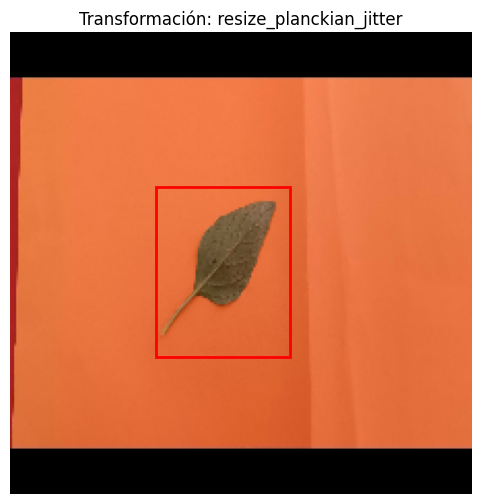

In [36]:
import matplotlib.pyplot as plt

# Supongamos que plot_anns es la función que dibuja las cajas en la imagen
def plot_anns(img, anns):
    labels, bbs = anns
    plt.imshow(img)
    ax = plt.gca()
    for bbox in bbs:
        x_min, y_min, width, height = bbox
        rect = plt.Rectangle((x_min, y_min), width, height, linewidth=2, edgecolor='red', facecolor='none')
        ax.add_patch(rect)
    plt.axis('off')

# Visualizamos cada transformación y sus cajas
for name, result in results.items():
    print(f"Mostrando resultado de la transformación '{name}':")
    img, bboxes, labels = result["image"], result["bboxes"], result["labels"]

    # Mostrar la imagen con las cajas
    plt.figure(figsize=(6, 6))
    plot_anns(img, (labels, bboxes))
    plt.title(f"Transformación: {name}")
    plt.show()


In [ ]:
def norm(bb, shape):
  # normalize bb
  # shape = (heigh, width)
  # bb = [x_min, y_min, width, height]
  h, w = shape
  return np.array([bb[0]/w, bb[1]/h, bb[2]/w, bb[3]/h])

def unnorm(bb, shape):
  # normalize bb
  # shape = (heigh, width)
  # bb = [x_min, y_min, width, height]
  h, w = shape
  return np.array([bb[0]*w, bb[1]*h, bb[2]*w, bb[3]*h])

In [30]:
import os

# Ruta de la carpeta principal
dataset_path = '/content/drive/MyDrive/Dataset_Hojas/plantas'

# Contar imágenes en cada subcarpeta
image_counts = {}
for folder in os.listdir(dataset_path):
    folder_path = os.path.join(dataset_path, folder)
    if os.path.isdir(folder_path):  # Verifica que sea una carpeta
        image_count = len([f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))])
        image_counts[folder] = image_count

# Mostrar los resultados
for folder, count in image_counts.items():
    print(f"Carpeta '{folder}' tiene {count} imágenes.")


Carpeta 'rucula' tiene 246 imágenes.
Carpeta 'malva' tiene 246 imágenes.
Carpeta 'tomillo' tiene 246 imágenes.
Carpeta 'hinojo' tiene 250 imágenes.
Carpeta 'albahaca' tiene 258 imágenes.


In [31]:
import os
import json
import cv2
import albumentations as A
import numpy as np
from pathlib import Path

def apply_augmentations(dataset_path, annotations_path, num_augmentations=1):
    """
    Aplica aumentaciones a las imágenes y actualiza las anotaciones.

    Args:
        dataset_path: Ruta base del dataset
        annotations_path: Ruta al archivo de anotaciones JSON
        num_augmentations: Número de aumentaciones por imagen
    """
    # Cargar las anotaciones
    with open(annotations_path, 'r') as f:
        annotations = json.load(f)

    # Crear el transformador con diferentes aumentaciones
    transform = A.Compose([
        A.Blur(blur_limit=(3, 7), p=0.5),
        A.RandomBrightnessContrast(p=0.5),
        A.RandomRotate90(p=0.5),
        A.HorizontalFlip(p=0.5),
        A.ChannelDropout(p=1.0),
        A.RingingOvershoot()
    ], bbox_params={'format': 'coco', 'min_area': 0., 'min_visibility': 0.3, 'label_fields': ['labels']})

    # Obtener el último ID de imagen y anotación
    last_image_id = max(img['id'] for img in annotations['images'])
    last_annotation_id = max(ann['id'] for ann in annotations['annotations'])

    new_images = []
    new_annotations = []

    # Procesar cada imagen
    for img_info in annotations['images']:
        # Construir la ruta completa de la imagen
        img_path = os.path.join(dataset_path, img_info['file_name'].replace('\\', '/'))

        # Leer la imagen
        image = cv2.imread(img_path)
        if image is None:
            print(f"Error reading image: {img_path}")
            continue

        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Obtener las anotaciones para esta imagen
        image_annotations = [ann for ann in annotations['annotations']
                           if ann['image_id'] == img_info['id']]

        # Realizar aumentaciones
        for aug_idx in range(num_augmentations):
            # Preparar los bboxes y labels para albumentations
            bboxes = [ann['bbox'] for ann in image_annotations]
            labels = [ann['category_id'] for ann in image_annotations]

            # Aplicar aumentación
            augmented = transform(
                image=image,
                bboxes=bboxes,
                labels=labels
            )

            # Generar nuevo nombre de archivo y ruta
            original_filename = Path(img_info['file_name'])
            new_filename = f"{original_filename.stem}_aug_{aug_idx}{original_filename.suffix}"
            new_filepath = str(original_filename.parent / new_filename)

            # Incrementar IDs
            last_image_id += 1

            # Guardar la imagen aumentada
            save_path = os.path.join(dataset_path, new_filepath)
            os.makedirs(os.path.dirname(save_path), exist_ok=True)
            cv2.imwrite(save_path, cv2.cvtColor(augmented['image'], cv2.COLOR_RGB2BGR))

            # Crear nueva entrada de imagen
            new_images.append({
                'id': last_image_id,
                'file_name': new_filepath,
                'height': augmented['image'].shape[0],
                'width': augmented['image'].shape[1]
            })

            # Crear nuevas anotaciones
            for bbox, label, original_ann in zip(augmented['bboxes'], augmented['labels'], image_annotations):
                last_annotation_id += 1
                new_annotations.append({
                    'id': last_annotation_id,
                    'image_id': last_image_id,
                    'category_id': label,
                    'bbox': list(map(float, bbox)),
                    'area': float(bbox[2] * bbox[3]),
                    'iscrowd': 0,
                    'segmentation': []
                })

    # Actualizar el JSON con las nuevas imágenes y anotaciones
    annotations['images'].extend(new_images)
    annotations['annotations'].extend(new_annotations)

    # Guardar el JSON actualizado
    with open(annotations_path, 'w') as f:
        json.dump(annotations, f, indent=2)

    print(f"Proceso completado. Se añadieron {len(new_images)} nuevas imágenes y {len(new_annotations)} nuevas anotaciones.")

# Ejemplo de uso:
dataset_path = "/content/drive/MyDrive/Dataset_Hojas/plantas"
annotations_path = "/content/drive/MyDrive/Dataset_Hojas/hojas_final_ann.json"
apply_augmentations(dataset_path, annotations_path, num_augmentations=6)

Error reading image: /content/drive/MyDrive/Dataset_Hojas/plantas/albahaca/IMG_20241114_120657.jpg
Error reading image: /content/drive/MyDrive/Dataset_Hojas/plantas/albahaca/IMG_20241114_120717.jpg
Error reading image: /content/drive/MyDrive/Dataset_Hojas/plantas/albahaca/IMG_20241114_120657_aug_0.jpg
Error reading image: /content/drive/MyDrive/Dataset_Hojas/plantas/albahaca/IMG_20241114_120657_aug_1.jpg
Error reading image: /content/drive/MyDrive/Dataset_Hojas/plantas/albahaca/IMG_20241114_120657_aug_2.jpg
Error reading image: /content/drive/MyDrive/Dataset_Hojas/plantas/albahaca/IMG_20241114_120657_aug_3.jpg
Error reading image: /content/drive/MyDrive/Dataset_Hojas/plantas/albahaca/IMG_20241114_120717_aug_0.jpg
Error reading image: /content/drive/MyDrive/Dataset_Hojas/plantas/albahaca/IMG_20241114_120717_aug_1.jpg
Error reading image: /content/drive/MyDrive/Dataset_Hojas/plantas/albahaca/IMG_20241114_120717_aug_2.jpg
Error reading image: /content/drive/MyDrive/Dataset_Hojas/plantas/a

In [32]:
import os

# Ruta de la carpeta principal
dataset_path = '/content/drive/MyDrive/Dataset_Hojas/plantas'

# Contar imágenes en cada subcarpeta
image_counts = {}
for folder in os.listdir(dataset_path):
    folder_path = os.path.join(dataset_path, folder)
    if os.path.isdir(folder_path):  # Verifica que sea una carpeta
        image_count = len([f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))])
        image_counts[folder] = image_count

# Mostrar los resultados
for folder, count in image_counts.items():
    print(f"Carpeta '{folder}' tiene {count} imágenes.")


Carpeta 'rucula' tiene 1520 imágenes.
Carpeta 'malva' tiene 1520 imágenes.
Carpeta 'tomillo' tiene 1520 imágenes.
Carpeta 'hinojo' tiene 1550 imágenes.
Carpeta 'albahaca' tiene 1488 imágenes.


In [45]:
import os

# Ruta de la carpeta principal
dataset_path = '/content/drive/MyDrive/Dataset_Hojas/plantas'

# Contar imágenes en cada subcarpeta
image_counts = {}
for folder in os.listdir(dataset_path):
    folder_path = os.path.join(dataset_path, folder)
    if os.path.isdir(folder_path):  # Verifica que sea una carpeta
        image_count = len([f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))])
        image_counts[folder] = image_count

# Mostrar los resultados
for folder, count in image_counts.items():
    print(f"Carpeta '{folder}' tiene {count} imágenes.")


Carpeta 'rucula' tiene 1520 imágenes.
Carpeta 'malva' tiene 1520 imágenes.
Carpeta 'tomillo' tiene 1520 imágenes.
Carpeta 'hinojo' tiene 1550 imágenes.
Carpeta 'albahaca' tiene 1488 imágenes.


In [ ]:
import json

# Ruta al archivo JSON
annotations_file = '/content/drive/MyDrive/Dataset_Hojas/hojas_final_ann.json'

# Cargar el archivo JSON
with open(annotations_file, 'r') as f:
    data = json.load(f)

# Corregir las rutas de las imágenes
for annotation in data['images']:
    if 'file_name' in annotation:
        annotation['file_name'] = annotation['file_name'].replace('\\', '/')

# Guardar el archivo actualizado
with open(annotations_file, 'w') as f:
    json.dump(data, f, indent=4)

print("Rutas de imágenes actualizadas en el archivo JSON.")


Rutas de imágenes actualizadas en el archivo JSON.


In [54]:
import json
import os

# Rutas de los archivos y carpetas
json_path = "/content/drive/MyDrive/Dataset_Hojas/hojas_final_ann.json"
images_base_path = "/content/drive/MyDrive/Dataset_Hojas/plantas"

# Leer el archivo JSON
with open(json_path, "r") as file:
    data = json.load(file)

# Crear nuevas listas para las anotaciones filtradas
filtered_images = []
filtered_annotations = []

# Crear un conjunto con los IDs de imágenes existentes
valid_image_ids = set()

# Verificar existencia de cada archivo de imagen
for image_info in data["images"]:
    file_name = image_info["file_name"]
    image_path = os.path.join(images_base_path, file_name)

    # Si el archivo existe, agregar a la lista de imágenes filtradas
    if os.path.exists(image_path):
        filtered_images.append(image_info)
        valid_image_ids.add(image_info["id"])
    else:
        print(f"Archivo faltante: {file_name}")

# Filtrar las anotaciones correspondientes a imágenes válidas
for annotation in data["annotations"]:
    if annotation["image_id"] in valid_image_ids:
        filtered_annotations.append(annotation)

# Crear un nuevo diccionario con las imágenes y anotaciones filtradas
filtered_data = {
    "images": filtered_images,
    "annotations": filtered_annotations
}

# Guardar el nuevo JSON filtrado
filtered_json_path = "/content/drive/MyDrive/Dataset_Hojas/hojas_final_ann_filtrado.json"
with open(filtered_json_path, "w") as file:
    json.dump(filtered_data, file, indent=4)

print("Anotaciones filtradas guardadas en:", filtered_json_path)


Archivo faltante: albahaca/IMG_20241114_120657.jpg
Archivo faltante: albahaca/IMG_20241114_120717.jpg
Archivo faltante: albahaca/IMG_20241114_120657_aug_0.jpg
Archivo faltante: albahaca/IMG_20241114_120657_aug_1.jpg
Archivo faltante: albahaca/IMG_20241114_120657_aug_2.jpg
Archivo faltante: albahaca/IMG_20241114_120717_aug_0.jpg
Archivo faltante: albahaca/IMG_20241114_120717_aug_2.jpg
Archivo faltante: albahaca/IMG_20241114_120717_aug_3.jpg
Anotaciones filtradas guardadas en: /content/drive/MyDrive/Dataset_Hojas/hojas_final_ann_filtrado.json


In [59]:
# if your dataset is in COCO format, this cell can be replaced by the following three lines:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("hojas7_train", {}, "/content/drive/MyDrive/Dataset_Hojas/hojas_final_ann.json", "/content/drive/MyDrive/Dataset_Hojas/plantas")
register_coco_instances("hojas7_val", {}, "/content/drive/MyDrive/INTELIGENCIA_ARTIFICIAL_SIS421/prueba/annotations.json", "/content/drive/MyDrive/INTELIGENCIA_ARTIFICIAL_SIS421/prueba")

In [60]:
from detectron2.data import DatasetCatalog

def print_image_paths(dataset_name):
    dataset_dicts = DatasetCatalog.get(dataset_name)
    for d in dataset_dicts:
        print(d["file_name"])

print_image_paths("hojas2_train")
print_image_paths("hojas2_val")


WARNING [11/14 19:33:09 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[11/14 19:33:09 d2.data.datasets.coco]: Loaded 1225 images in COCO format from /content/drive/MyDrive/Dataset_Hojas/hojas_final_ann.json
/content/drive/MyDrive/Dataset_Hojas/plantas/albahaca/IMG_20241114_120634.jpg
/content/drive/MyDrive/Dataset_Hojas/plantas/albahaca/IMG_20241114_120636.jpg
/content/drive/MyDrive/Dataset_Hojas/plantas/albahaca/IMG_20241114_120640.jpg
/content/drive/MyDrive/Dataset_Hojas/plantas/albahaca/IMG_20241114_120642.jpg
/content/drive/MyDrive/Dataset_Hojas/plantas/albahaca/IMG_20241114_120646.jpg
/content/drive/MyDrive/Dataset_Hojas/plantas/albahaca/IMG_20241114_120648.jpg
/content/drive/MyDrive/Dataset_Hojas/plantas/albahaca/IMG_20241114_120649.jpg
/content/drive/MyDrive/Dataset_Hojas/plantas/albahaca/IMG_20241114_120653.jpg
/content/drive/MyDrive/Dataset_Hojas/plantas/albahaca/IMG_20241114_120655.jpg
/content/drive/MyDrive/

In [61]:
import os
import numpy as np
import matplotlib.pyplot as plt
from detectron2.engine import DefaultTrainer, HookBase
from detectron2.config import get_cfg
from detectron2 import model_zoo
import torch

class LossTrackingHook(HookBase):
    def __init__(self):
        super().__init__()
        self.classification_losses = []
        self.localization_losses = []
        self.iterations = []

    def after_step(self):
        # Extraer las pérdidas del storage
        stats = self.trainer.storage.latest()

        # Guardar las pérdidas de clasificación (combinamos loss_cls y loss_rpn_cls)
        cls_loss = stats['loss_cls'] + stats['loss_rpn_cls']
        self.classification_losses.append(cls_loss)

        # Guardar las pérdidas de localización (combinamos loss_box_reg y loss_rpn_loc)
        loc_loss = stats['loss_box_reg'] + stats['loss_rpn_loc']
        self.localization_losses.append(loc_loss)

        # Guardar la iteración actual
        self.iterations.append(self.trainer.iter)

        # Guardar el modelo cada 1000 iteraciones
        if self.trainer.iter % 3000 == 0:
            checkpoint_path = os.path.join(cfg.OUTPUT_DIR, f"model_iter_{self.trainer.iter}.pth")
            torch.save(self.trainer.model.state_dict(), checkpoint_path)
            print(f"Modelo guardado en: {checkpoint_path}")

    def after_train(self):
        # Guardar el modelo final
        final_model_path = os.path.join(cfg.OUTPUT_DIR, "model_hojas_aumentado.pth")
        torch.save(self.trainer.model.state_dict(), final_model_path)
        print(f"Modelo final guardado en: {final_model_path}")

        # Convertir las listas a arrays de numpy
        iterations = np.array(self.iterations)
        cls_losses = np.array(self.classification_losses)
        loc_losses = np.array(self.localization_losses)

        # Crear la gráfica
        plt.figure(figsize=(12, 6))
        plt.plot(iterations, cls_losses, label='Pérdida de Clasificación', color='blue')
        plt.plot(iterations, loc_losses, label='Pérdida de Localización', color='red')
        plt.xlabel('Iteraciones')
        plt.ylabel('Pérdida')
        plt.title('Pérdidas durante el entrenamiento')
        plt.legend()
        plt.grid(True)

        # Guardar la gráfica
        plt.savefig(os.path.join(cfg.OUTPUT_DIR, 'training_losses.png'))
        plt.close()

        # También guardar los datos numéricos
        np.save(os.path.join(cfg.OUTPUT_DIR, 'classification_losses.npy'), cls_losses)
        np.save(os.path.join(cfg.OUTPUT_DIR, 'localization_losses.npy'), loc_losses)
        np.save(os.path.join(cfg.OUTPUT_DIR, 'iterations.npy'), iterations)


# **EL MODELO**

**maskrcnn_resnet50_fpn**


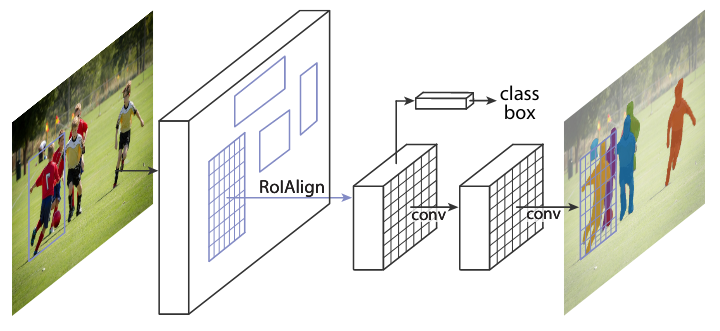

Mask R-CNN extiende un modelo anterior, Faster R-CNN, que se centra en la detección de objetos. Mask R-CNN agrega una nueva rama al modelo de Faster R-CNN que se encarga de generar una máscara de píxeles para cada objeto detectado. Esta rama trabaja en paralelo con la de detección de cuadros delimitadores, permitiendo identificar y segmentar cada instancia de manera simultánea.

**Backbone**

El backbone es la red principal utilizada para extraer características de bajo y alto nivel de una imagen. Esta extracción de características es crucial para la detección y segmentación de objetos en modelos avanzados de visión.

ResNet-50 es una red neuronal profunda diseñada para tareas de clasificación y extracción de características en imágenes. Su estructura se destaca por el uso de "bloques residuales", una innovación que permite entrenar redes mucho más profundas sin enfrentar el problema de la "desaparición del gradiente".

**Estructura General de ResNet-50**
Capa de entrada: bloque de convoluciones y max-pooling.

**Etapa 1 a 4:** Bloques residuales con convoluciones que extraen patrones cada vez más complejos.

**Bloques Residuales:**
Estos bloques permiten "saltar" capas mediante conexiones de atajo (skip connections), lo que facilita el paso directo de la información. Este diseño se compone de:

Conexiones de atajo (skip connections): Cada entrada se suma a la salida después de pasar por varias capas convolucionales, lo cual mitiga la pérdida de información.
Capas internas: Cada bloque incluye capas de convolución de 1x1, 3x3 y 1x1, que son responsables de reducir y luego expandir la dimensión de los canales, manteniendo al mismo tiempo la capacidad de aprendizaje.

**Region Proposal Network (RPN)**
genera "propuestas de región". Estas propuestas son secciones de la imagen donde es probable que haya un objeto. La RPN utiliza anclas, o cajas de diferentes tamaños y relaciones de aspecto, para evaluar posibles regiones. Este módulo filtra las áreas de la imagen que no contienen objetos, reduciendo el número de regiones a analizar.


**ROI Align (Alineación de Regiones de Interés)**
sustituye al ROI Pooling de Faster R-CNN. En ROI Pooling, los valores de las características se ajustan a un tamaño fijo usando una aproximación que causa pérdida de precisión. Con ROI Align, esta pérdida se minimiza, ya que se aplican interpolaciones bilineales en las características de las regiones. Esto permite una segmentación más precisa, ya que conserva mejor la información espacial.


**Ramas de Clasificación y Regresión de Cajas**

Estas ramas toman como entrada las características generadas para cada región y predicen la clase del objeto (como "persona", "bicicleta" o "perro") y su caja ajustada para una localización más precisa.

**Rama de Segmentación de Máscaras**
es un pequeño submodelo que predice una máscara de píxeles para cada objeto detectado en la imagen. Esta máscara representa la forma del objeto de manera pixelada. La rama de segmentación es una red totalmente convolucional (FCN) que produce una máscara de tamaño fijo para cada propuesta de región, mejorando así la precisión de segmentación.


**Flujo de Procesamiento en Mask R-CNN**

La imagen de entrada pasa por el backbone, generando mapas de características en varias resoluciones.

La RPN genera propuestas de región sobre los mapas de características.

ROI Align toma estas propuestas y ajusta las características a un tamaño fijo sin perder precisión.

Las características de cada región pasan por las ramas de clasificación, regresión de cajas y segmentación para predecir:

La clase del objeto.

La posición refinada de su caja delimitadora.

La máscara de segmentación de píxeles para la región del objeto.


In [64]:
# Configuración del modelo (el resto de tu configuración se mantiene igual)
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("hojas7_train",)
cfg.DATASETS.TEST = ("hojas7_val",)
cfg.DATALOADER.NUM_WORKERS = 2 #son los subprocesos, o hilos para cargar datos a la vez pero consumen mas memoria
cfg.MODEL.WEIGHTS = "/content/drive/MyDrive/Dataset_Hojas/model_hojas_aumentado.pth"
cfg.SOLVER.IMS_PER_BATCH = 4 # 4 imagenes por lote
cfg.SOLVER.BASE_LR = 0.00002
cfg.SOLVER.MAX_ITER = 2000
cfg.SOLVER.STEPS = [] #Lista de iteraciones donde se ajustará la tasa de aprendizaje
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128 #efine el tamaño de lote para las propuestas de región de interés (ROI) por cada imagen
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 5
cfg.MODEL.MASK_ON = False

# Directorio de salida
output_dir = "/content/drive/MyDrive/Dataset_Hojas"
cfg.OUTPUT_DIR = output_dir
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

# Entrenar el modelo con el hook personalizado
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
loss_hook = LossTrackingHook()  #para registrar la perdida por iteracion y monitorear el entrenamiento
trainer.register_hooks([loss_hook])
trainer.train()

[11/14 20:22:47 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.10/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

[11/14 20:22:48 d2.engine.train_loop]: Starting training from iteration 0
Modelo guardado en: /content/drive/MyDrive/Dataset_Hojas/model_iter_0.pth
[11/14 20:23:02 d2.utils.events]:  eta: 0:20:53  iter: 19  total_loss: 0.4642  loss_cls: 0.1247  loss_box_reg: 0.3297  loss_rpn_cls: 0.003983  loss_rpn_loc: 0.006117    time: 0.6310  last_time: 0.6287  data_time: 0.0439  last_data_time: 0.0179   lr: 3.9962e-07  max_mem: 5776M
[11/14 20:23:15 d2.utils.events]:  eta: 0:20:48  iter: 39  total_loss: 0.533  loss_cls: 0.1562  loss_box_reg: 0.3552  loss_rpn_cls: 0.004942  loss_rpn_loc: 0.005802    time: 0.6359  last_time: 0.6856  data_time: 0.0324  last_data_time: 0.0392   lr: 7.9922e-07  max_mem: 5776M
[11/14 20:23:27 d2.utils.events]:  eta: 0:20:47  iter: 59  total_loss: 0.5311  loss_cls: 0.149  loss_box_reg: 0.3601  loss_rpn_cls: 0.008675  loss_rpn_loc: 0.005443    time: 0.6346  last_time: 0.6494  data_time: 0.0258  last_data_time: 0.0127   lr: 1.1988e-06  max_mem: 5776M
[11/14 20:23:40 d2.util

[11/14 18:14:09 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/Dataset_Hojas/model_hojas_total.pth ...


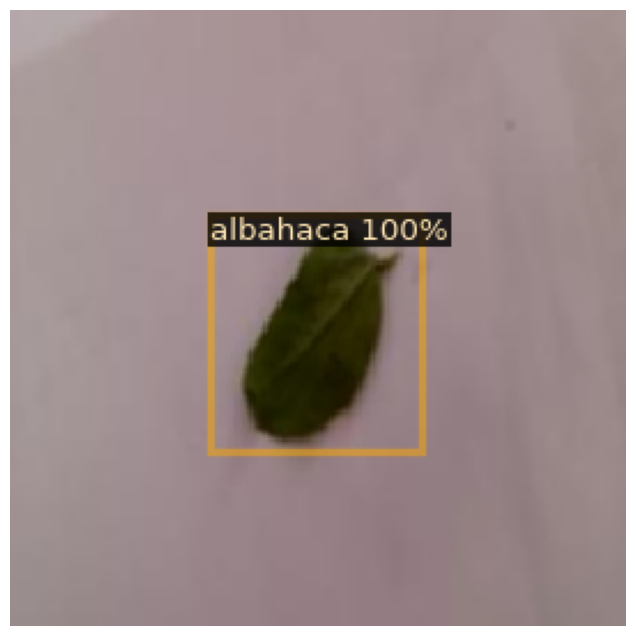

In [ ]:
import cv2
import matplotlib.pyplot as plt
from detectron2.engine import DefaultPredictor
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

# Ruta de la imagen que quieres predecir
image_path = "/content/drive/MyDrive/Dataset_Hojas/val/albahaca/Albahaca_102_aug_0.jpg"

# Cargar la imagen
image = cv2.imread(image_path)

# Configurar el predictor con la configuración de tu modelo
cfg.MODEL.WEIGHTS = "/content/drive/MyDrive/Dataset_Hojas/model_hojas_total.pth"  # Ruta al modelo entrenado
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # Umbral de confianza para mostrar predicciones
predictor = DefaultPredictor(cfg)

# Obtener predicciones
outputs = predictor(image)

# Visualizar la imagen con las cajas y máscaras de predicción
v = Visualizer(image[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))

# Mostrar la imagen con las predicciones
plt.figure(figsize=(12, 8))
plt.imshow(v.get_image())
plt.axis("off")
plt.show()


[11/10 23:21:46 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/Dataset_Hojas/model_hojas.pth ...


/usr/local/lib/python3.10/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

Clasificando imágenes de la categoría 'albahaca':


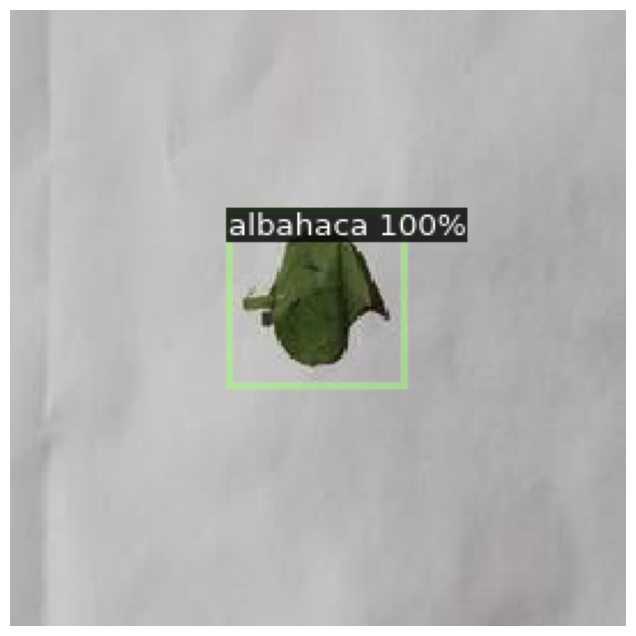

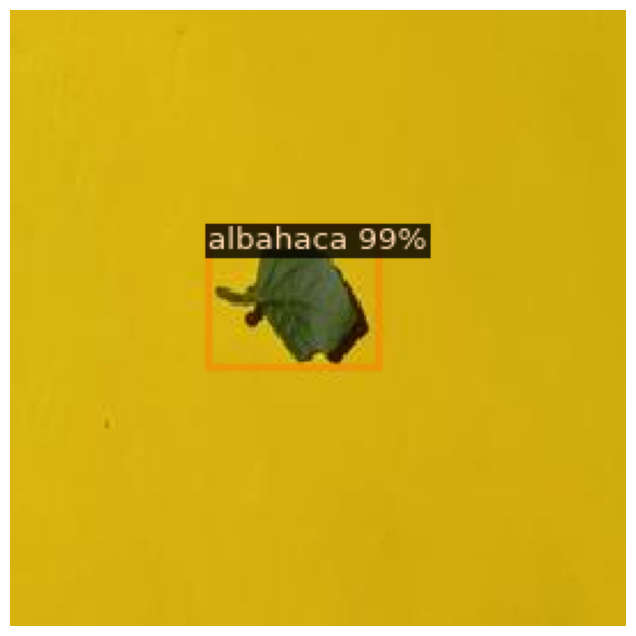

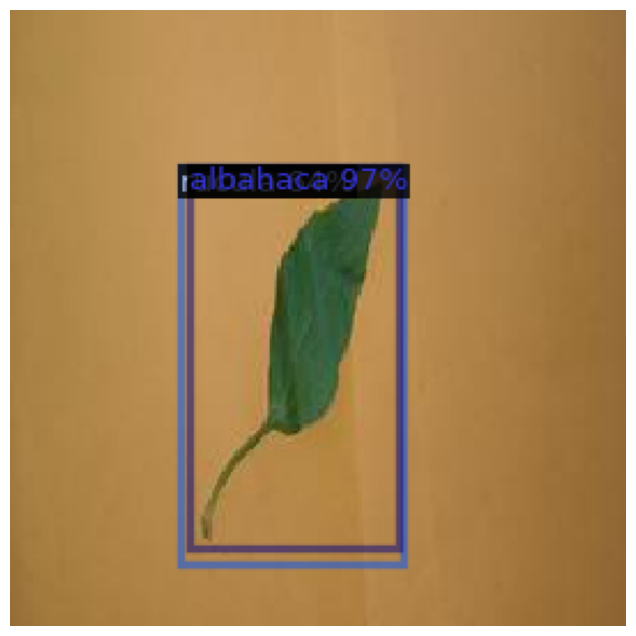

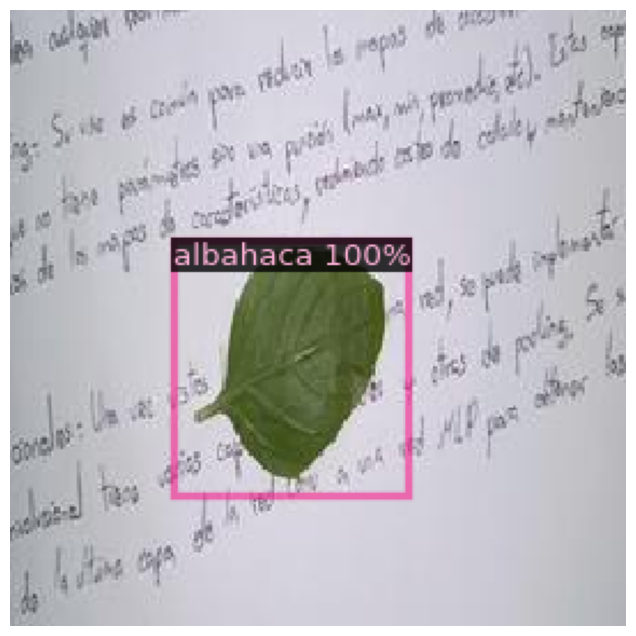

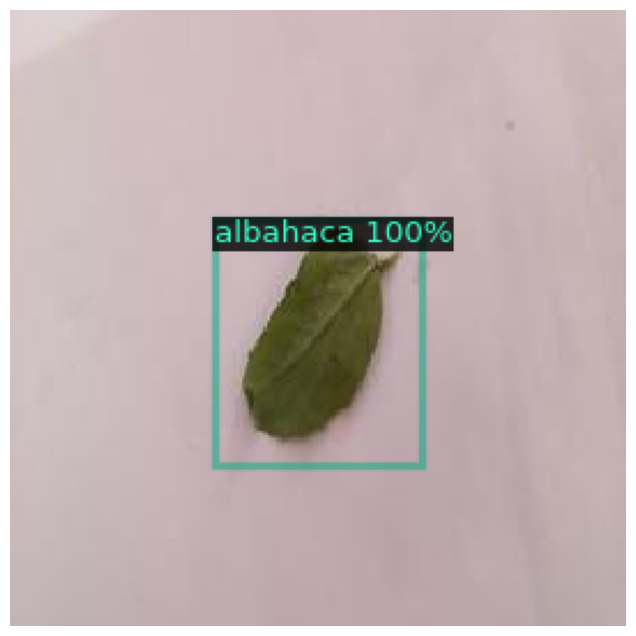

Clasificando imágenes de la categoría 'malva':


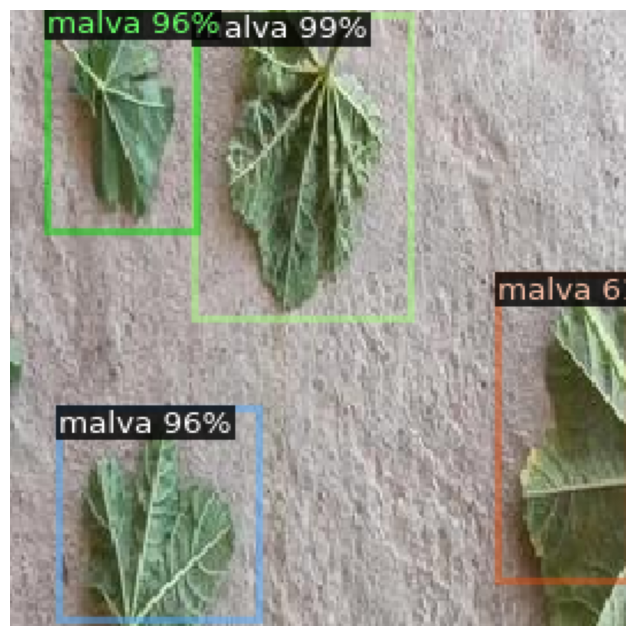

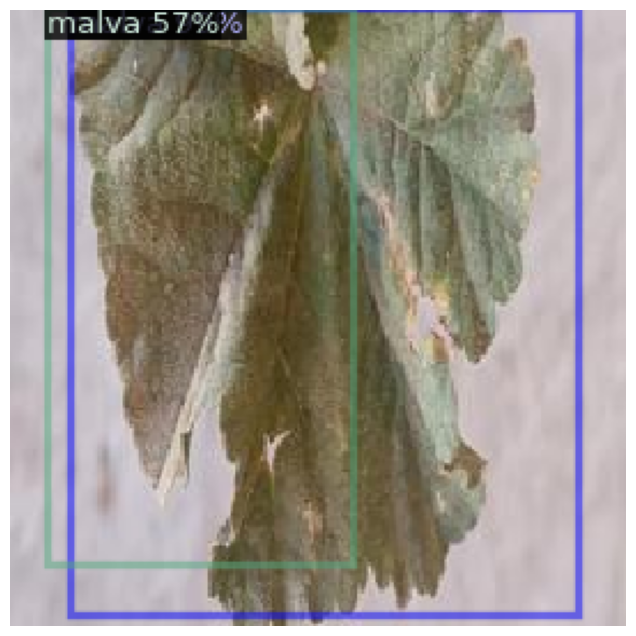

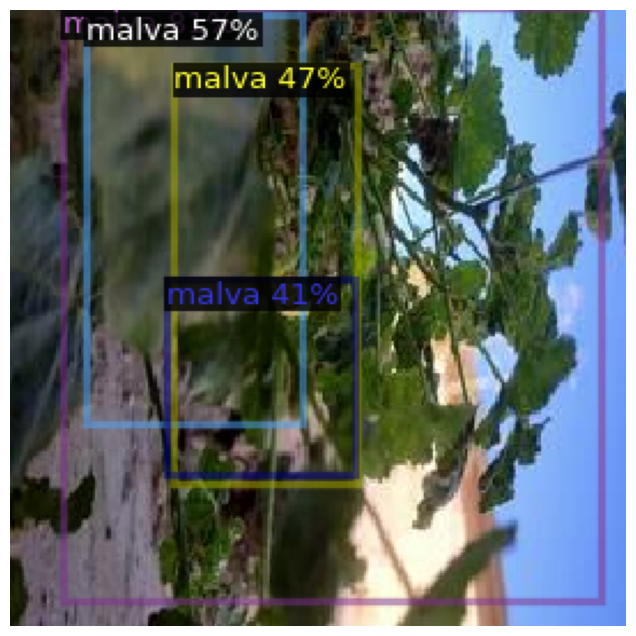

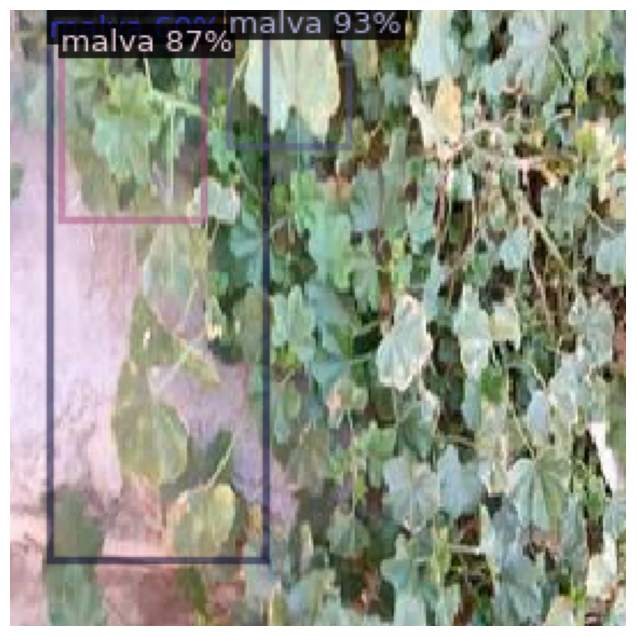

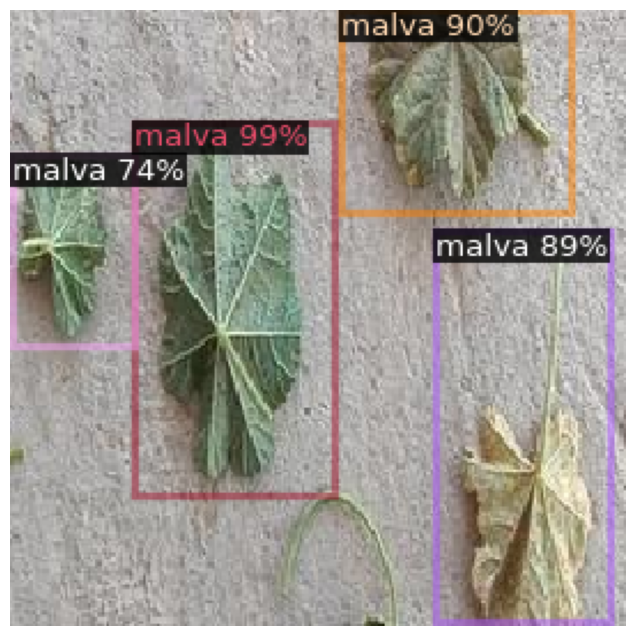

Clasificando imágenes de la categoría 'hinojo':


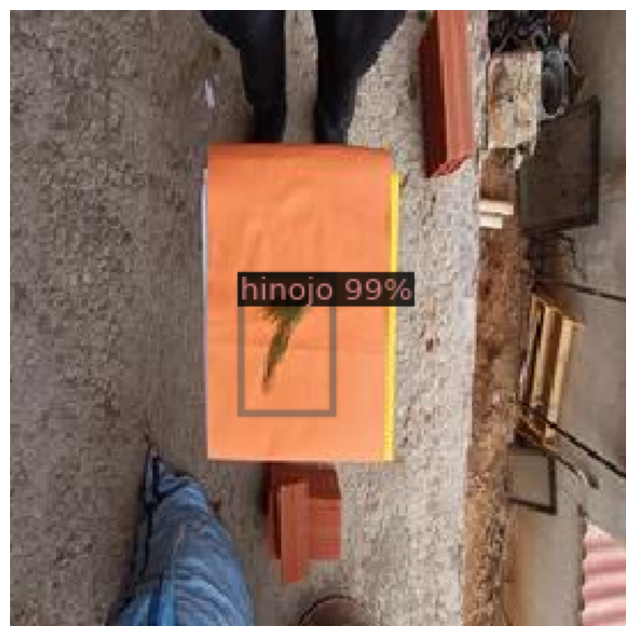

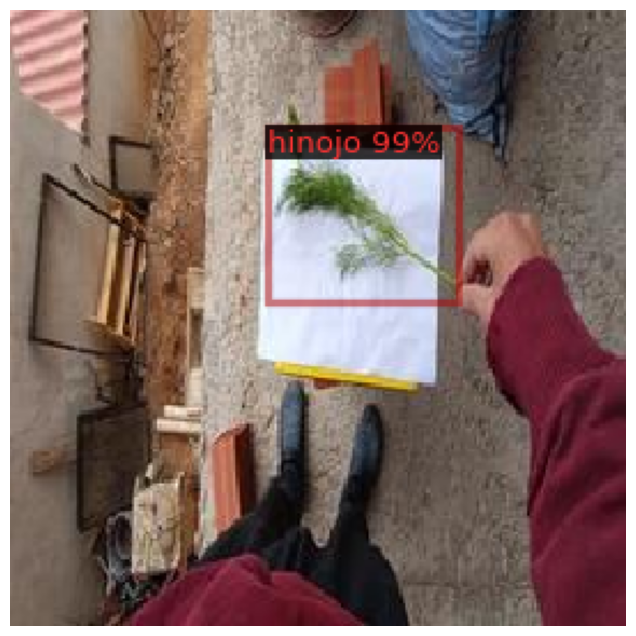

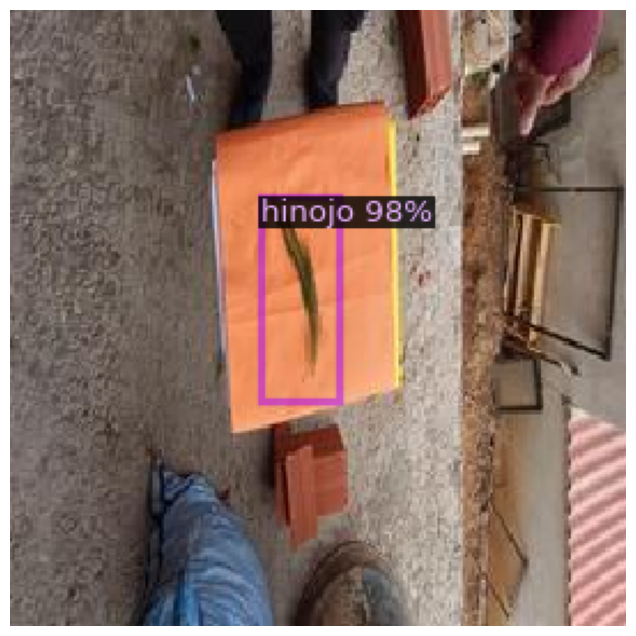

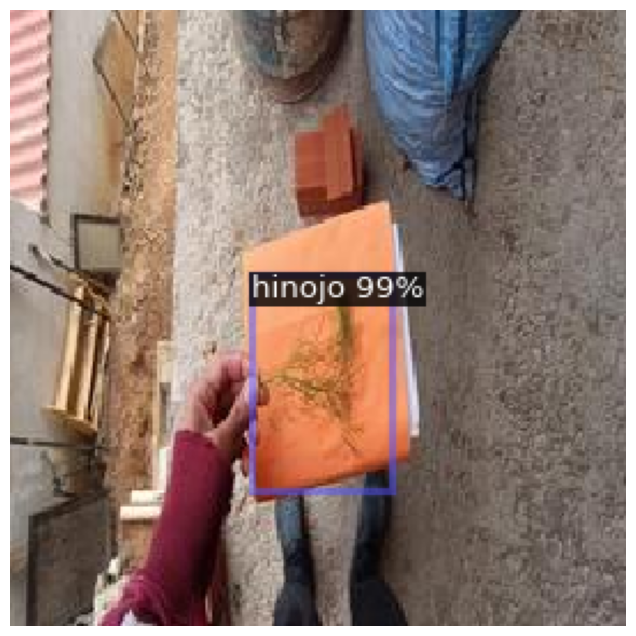

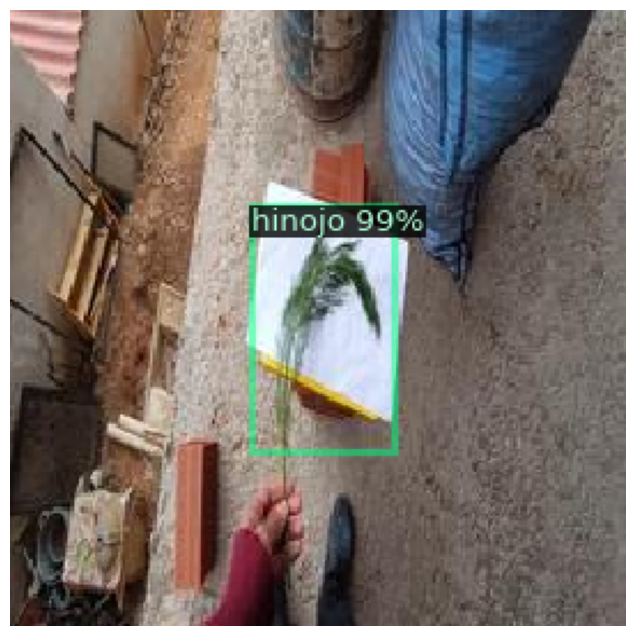

Clasificando imágenes de la categoría 'rucula':


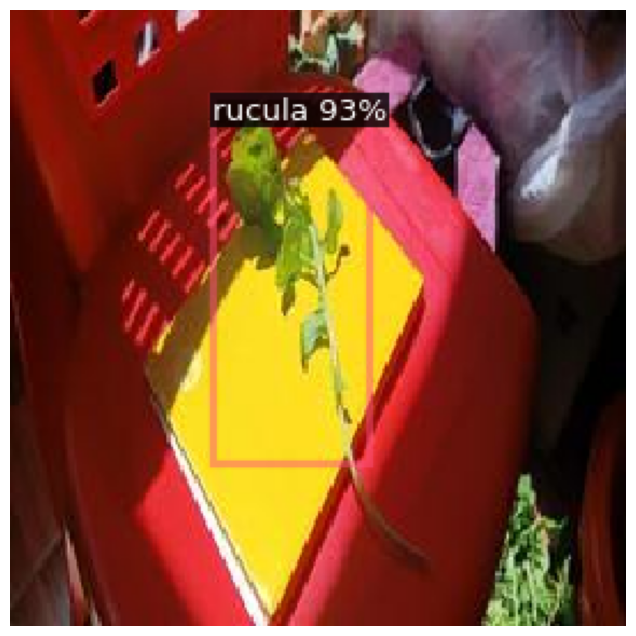

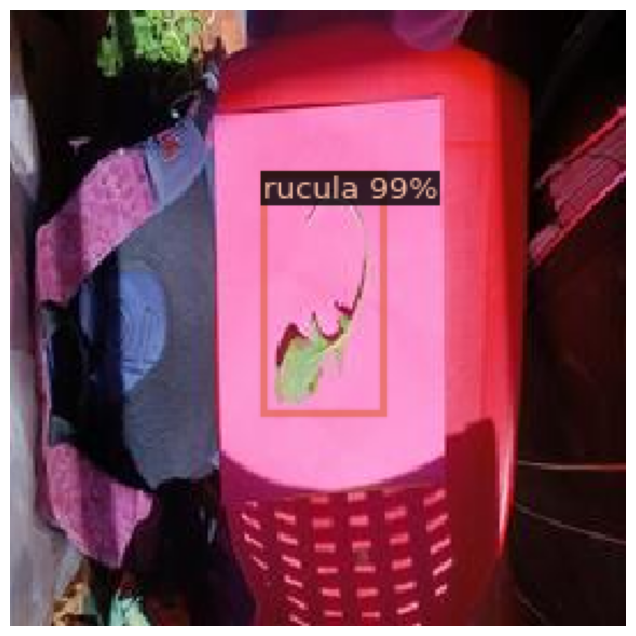

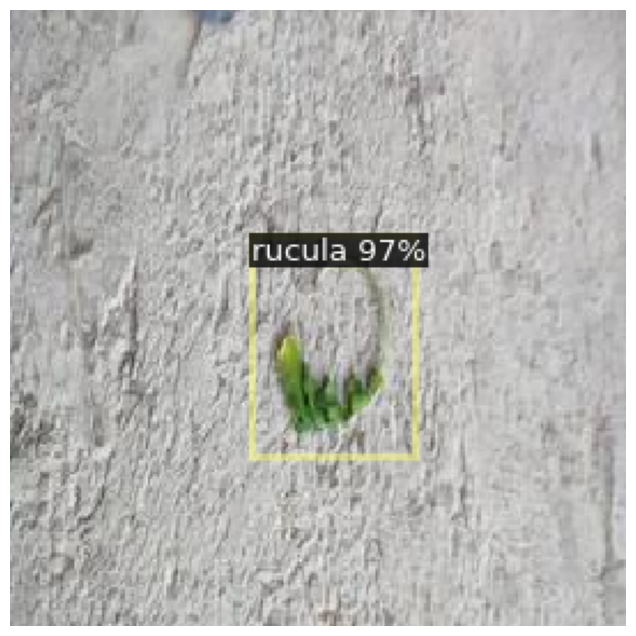

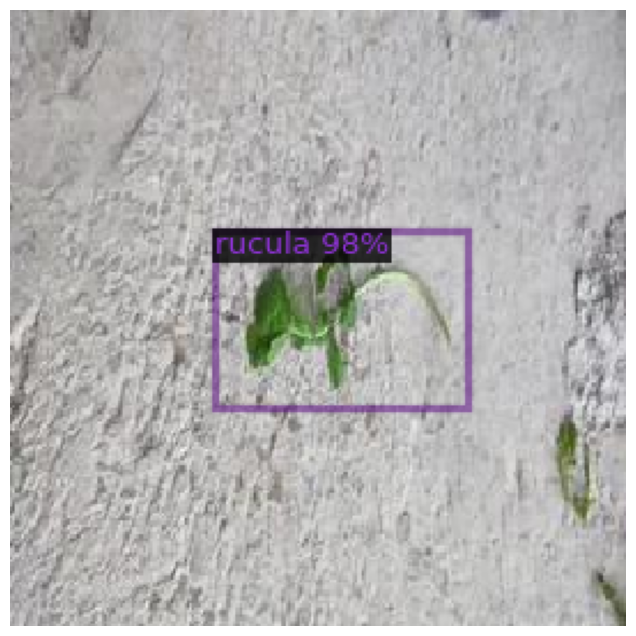

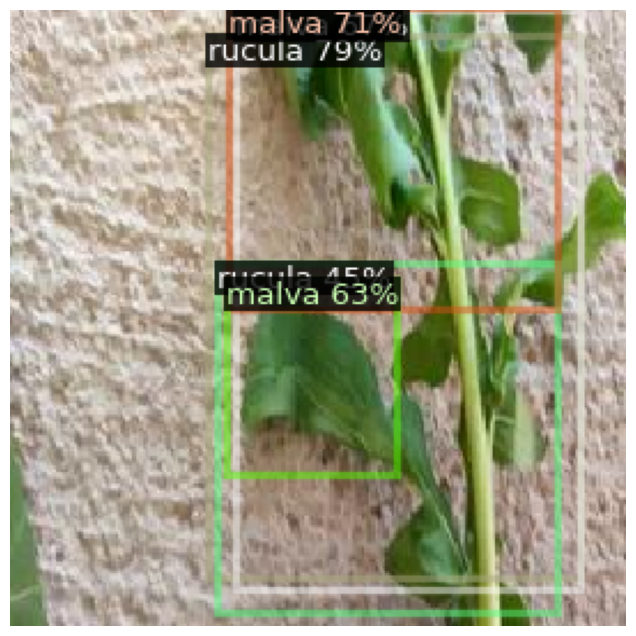

Clasificando imágenes de la categoría 'tomillo':


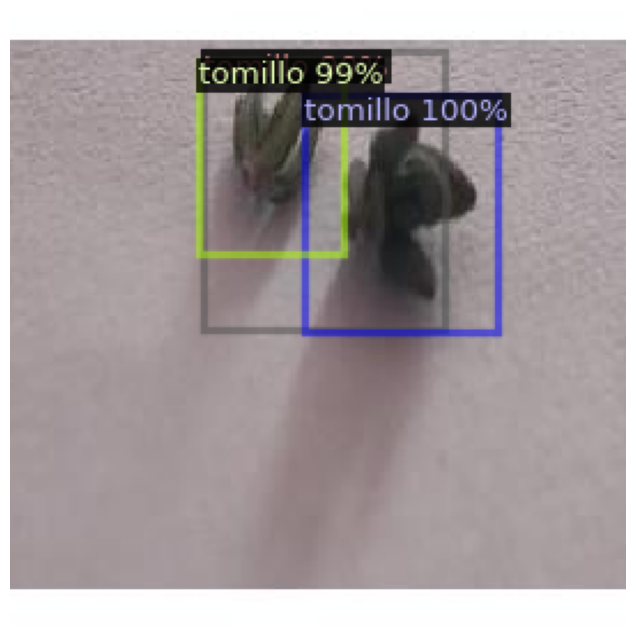

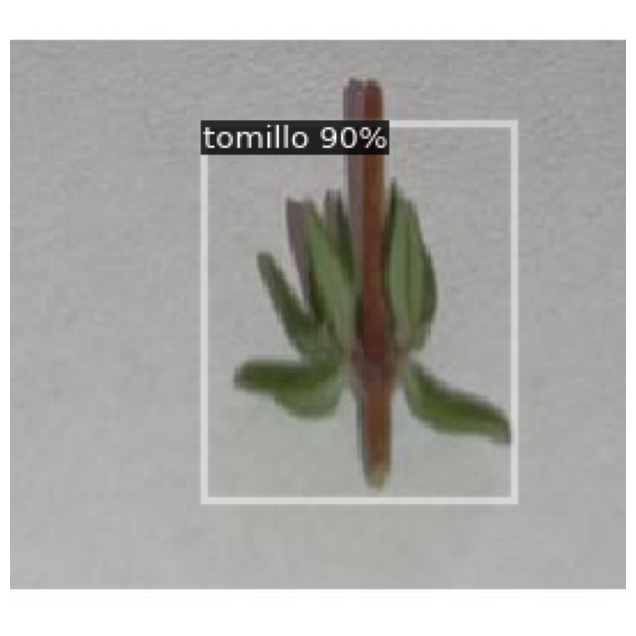

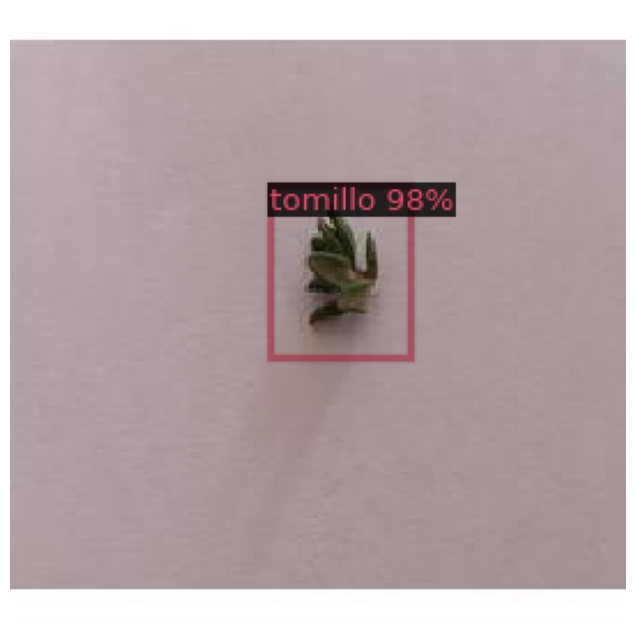

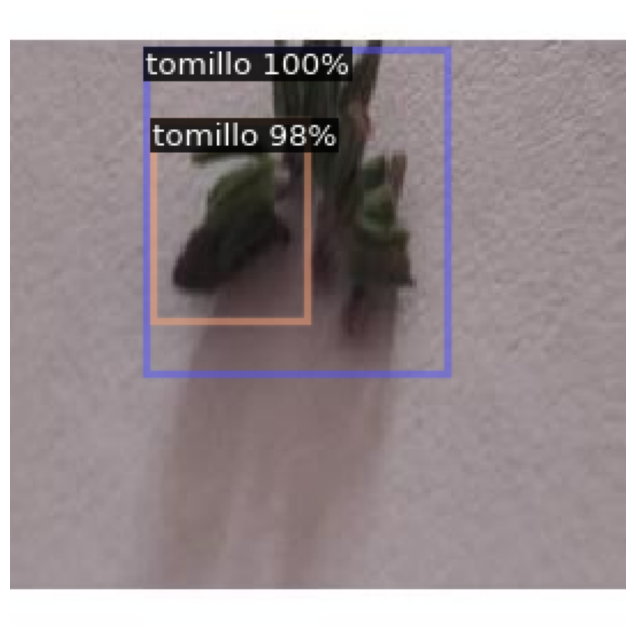

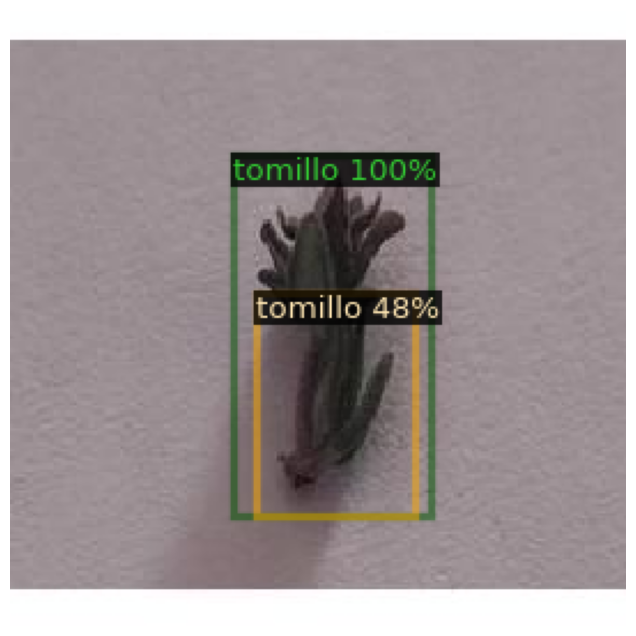

In [ ]:
import os
import random
import cv2
import matplotlib.pyplot as plt
from detectron2.engine import DefaultPredictor
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

# Ruta principal de las carpetas con imágenes
base_path = "/content/drive/MyDrive/INTELIGENCIA_ARTIFICIAL_SIS421/mmlab/Hojas_Dataset/val"
categories = ["albahaca", "malva", "hinojo", "rucula", "tomillo"]

# Configurar el predictor con la configuración de tu modelo
cfg.MODEL.WEIGHTS = "/content/drive/MyDrive/Dataset_Hojas/model_hojas.pth"  # Ruta al modelo entrenado
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.4  # Umbral de confianza para mostrar predicciones
predictor = DefaultPredictor(cfg)

# Función para procesar y mostrar la predicción de una imagen
def predict_and_display(image_path):
    # Cargar la imagen
    image = cv2.imread(image_path)

    # Obtener predicciones
    outputs = predictor(image)

    # Visualizar la imagen con las cajas y máscaras de predicción
    v = Visualizer(image[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    # Mostrar la imagen con las predicciones
    plt.figure(figsize=(12, 8))
    plt.imshow(v.get_image())
    plt.axis("off")
    plt.show()

# Iterar sobre cada categoría y seleccionar 5 imágenes aleatorias
for category in categories:
    category_path = os.path.join(base_path, category)
    if os.path.isdir(category_path):
        images = [img for img in os.listdir(category_path) if img.endswith(('.jpg', '.jpeg', '.png'))]
        random_images = random.sample(images, 5)  # Seleccionar 5 imágenes aleatorias

        print(f"Clasificando imágenes de la categoría '{category}':")
        for img_name in random_images:
            img_path = os.path.join(category_path, img_name)
            predict_and_display(img_path)


In [ ]:
import locale
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding
!sudo apt-get update
!sudo apt-get install locales
!sudo locale-gen en_US.UTF-8
!sudo update-locale LANG=en_US.UTF-8 LC_ALL=en_US.UTF-8
!export LC_ALL=en_US.UTF-8
!pip install onnx

Get:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,626 B]
Get:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Get:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages [1,108 kB]
Hit:4 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:5 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:6 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Hit:7 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:8 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Get:9 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Hit:10 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Get:11 https://r2u.stat.illinois.edu/ubuntu jammy/main all Packages [8,477 kB]
Get:12 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Get:13 http://security.ubuntu.com/ubuntu jammy-sec

In [ ]:
!pip install onnxruntime

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.3/13.3 MB 65.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 9.5 MB/s eta 0:00:00


In [ ]:
import torch
from detectron2.config import get_cfg
from detectron2.modeling import build_model
from detectron2.checkpoint import DetectionCheckpointer
from detectron2.export import TracingAdapter
from detectron2 import model_zoo
import onnxruntime as ort
import numpy as np
import cv2
import matplotlib.pyplot as plt
from glob import glob
import os

# Configuración del modelo
def setup_cfg():
    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
    cfg.DATASETS.TRAIN = ("hojitas_train",)
    cfg.DATASETS.TEST = ("hojitas_val",)
    cfg.MODEL.WEIGHTS = "/content/drive/MyDrive/Dataset_Hojas/model_hojas_total.pth"
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = 5
    cfg.MODEL.MASK_ON = False
    cfg.MODEL.DEVICE = "cpu"  # Importante para exportación
    return cfg

def export_to_onnx(cfg, sample_image_path):
    # Crear y cargar el modelo
    model = build_model(cfg)
    DetectionCheckpointer(model).load(cfg.MODEL.WEIGHTS)
    model.eval()

    # Preparar imagen de ejemplo para el trazado
    im = cv2.imread(sample_image_path)
    im = cv2.resize(im, (900, 800))  # Ajustar tamaño si es necesario
    im_torch = torch.as_tensor(im.astype("float32").transpose(2, 0, 1))
    inputs = [{"image": im_torch}] #lista de diccionarios para entrada al modelo

    # Crear modelo trazable
    traceable_model = TracingAdapter(model, inputs, None)
    #se envuelve el modelo para trazarlo y asi ajustar sus entradas y salidas para
    #ser compatibles con onnx.export


    # Exportar a ONNX
    onnx_path = "/content/drive/MyDrive/modelo_hojas_final.onnx"
    torch.onnx.export(
        traceable_model,
        (im_torch,),
        onnx_path,
        opset_version=16, #version de el conjunto de operaciones
        input_names=['image'],
        output_names=['boxes', 'classes', 'scores'],
        dynamic_axes={
            'image': {1: 'height', 2: 'width'}, #dimensiones 1 y dos (h y w) pueden variar
            'boxes': {0: 'batch_size'}, #batch de cajas varia
            'classes': {0: 'batch_size'},
            'scores': {0: 'batch_size'} #lo mismo, para permitir mas de una planta por img
        } #permite dimensiones dinamicas
    )
    print(f"Modelo exportado a: {onnx_path}")
    return onnx_path

def test_onnx_model(onnx_path, test_image_path):
    # Crear sesión ONNX Runtime
    session = ort.InferenceSession(onnx_path)

    # Cargar y preparar imagen de prueba
    im_test = cv2.imread(test_image_path)
    im_test = cv2.resize(im_test, (900, 800))  # Mismo tamaño que en exportación
    im_test_torch = torch.as_tensor(im_test.astype("float32").transpose(2, 0, 1))
    im_test_numpy = im_test_torch.detach().numpy()

    # Ejecutar inferencia
    outputs = session.run(None, {"image": im_test_numpy})
    boxes, classes, scores = outputs

    # Visualizar resultados
    plt.figure(figsize=(12, 8))
    plt.imshow(cv2.cvtColor(im_test, cv2.COLOR_BGR2RGB))

    # Dibujar cajas para todas las clases con score > 0.5
    for box, class_id, score in zip(boxes, classes, scores):
        if score > 0.5:  # Umbral de confianza
            x1, y1, x2, y2 = box
            plt.plot([x1, x2, x2, x1, x1], [y1, y1, y2, y2, y1],
                    label=f'Clase {int(class_id)} ({score:.2f})')

    plt.legend()
    plt.axis('off')
    plt.show()

# Uso principal
if __name__ == "__main__":
    # Configurar modelo
    cfg = setup_cfg()

    # Ruta a una imagen de ejemplo para exportación
    sample_image_path = "/content/drive/MyDrive/INTELIGENCIA_ARTIFICIAL_SIS421/dataHojas/malvavisco/albahacaA.png"  # Ajusta esta ruta

    # Exportar modelo
    onnx_path = export_to_onnx(cfg, sample_image_path)

[11/14 18:15:01 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/Dataset_Hojas/model_hojas_total.pth ...


/usr/local/lib/python3.10/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

Modelo exportado a: /content/drive/MyDrive/modelo_hojas_final.onnx


In [ ]:
def test_onnx_model(onnx_path, test_image_path):
    # Crear sesión ONNX Runtime
    session = ort.InferenceSession(onnx_path)

    # Cargar y preparar imagen de prueba
    im_test = cv2.imread(test_image_path)
    im_test = cv2.resize(im_test, (900, 800))  # Mismo tamaño que en exportación
    im_test_torch = torch.as_tensor(im_test.astype("float32").transpose(2, 0, 1))
    im_test_numpy = im_test_torch.detach().numpy()

    # Ejecutar inferencia
    outputs = session.run(None, {"image": im_test_numpy})
     # Access the outputs by index
    boxes = outputs[0]
    classes = outputs[1]
    scores = outputs[2]

    # Visualizar resultados
    plt.figure(figsize=(12, 8))
    plt.imshow(cv2.cvtColor(im_test, cv2.COLOR_BGR2RGB))

    # Dibujar cajas para todas las clases con score > 0.5
    for box, class_id, score in zip(boxes, classes, scores):
        if score > 0.5:  # Umbral de confianza
            x1, y1, x2, y2 = box
            plt.plot([x1, x2, x2, x1, x1], [y1, y1, y2, y2, y1],
                    label=f'Clase {int(class_id)} ({score:.2f})')

    plt.legend()
    plt.axis('off')
    plt.show()

In [ ]:
def test_onnx_model(onnx_path, test_image_path):
    # Crear sesión ONNX Runtime
    session = ort.InferenceSession(onnx_path)

    # Cargar y preparar imagen de prueba
    im_test = cv2.imread(test_image_path)
    im_test = cv2.resize(im_test, (900, 800))  # Mismo tamaño que en exportación
    im_test_torch = torch.as_tensor(im_test.astype("float32").transpose(2, 0, 1))
    im_test_numpy = im_test_torch.detach().numpy()

    # Ejecutar inferencia
    outputs = session.run(None, {"image": im_test_numpy})
     # Access the outputs by index
    boxes = outputs[0]
    classes = outputs[1]
    scores = outputs[2]

    # Visualizar resultados
    plt.figure(figsize=(12, 8))
    plt.imshow(cv2.cvtColor(im_test, cv2.COLOR_BGR2RGB))

    # Dibujar cajas para todas las clases con score > 0.5
    for box, class_id, score in zip(boxes, classes, scores):
        if score > 0.5:  # Umbral de confianza
            x1, y1, x2, y2 = box
            plt.plot([x1, x2, x2, x1, x1], [y1, y1, y2, y2, y1],
                    label=f'Clase {int(class_id)} ({score:.2f})')

    plt.legend()
    plt.axis('off')
    plt.show()

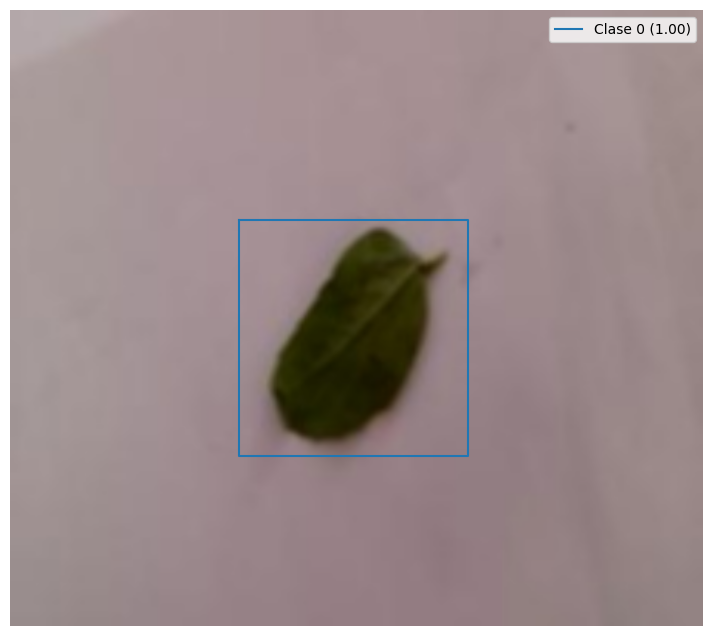

In [ ]:
test_image_path = "/content/drive/MyDrive/Dataset_Hojas/val/albahaca/Albahaca_102_aug_0.jpg"
test_onnx_model("/content/drive/MyDrive/modelo_hojas_final.onnx", test_image_path)

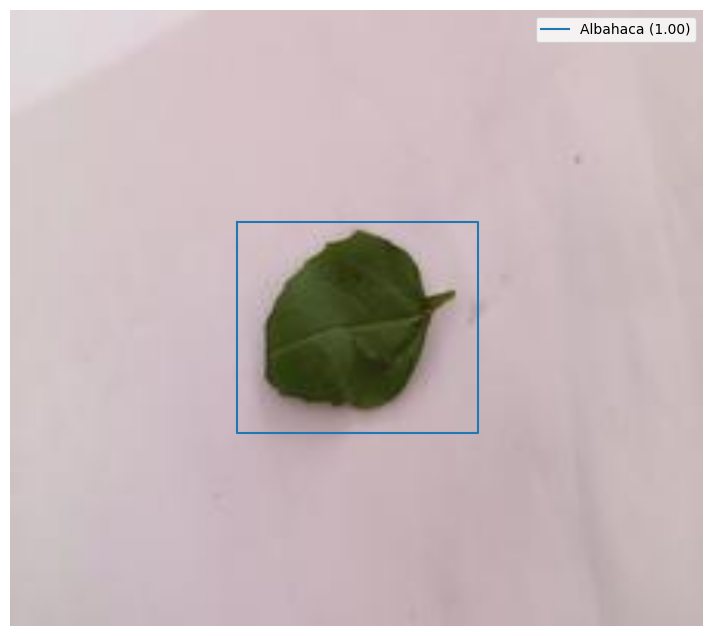

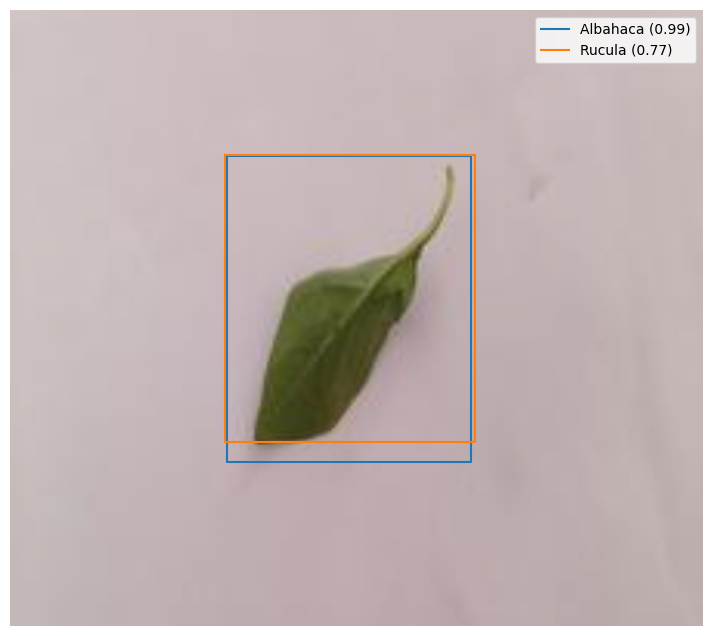

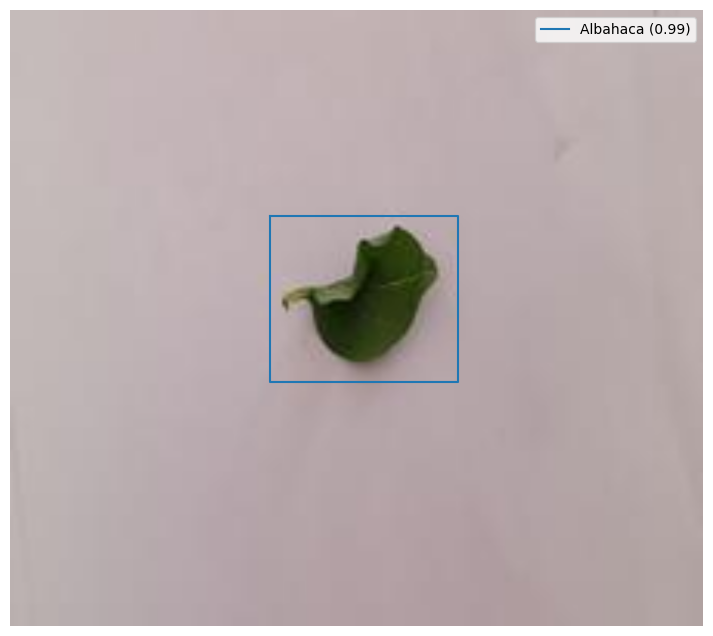

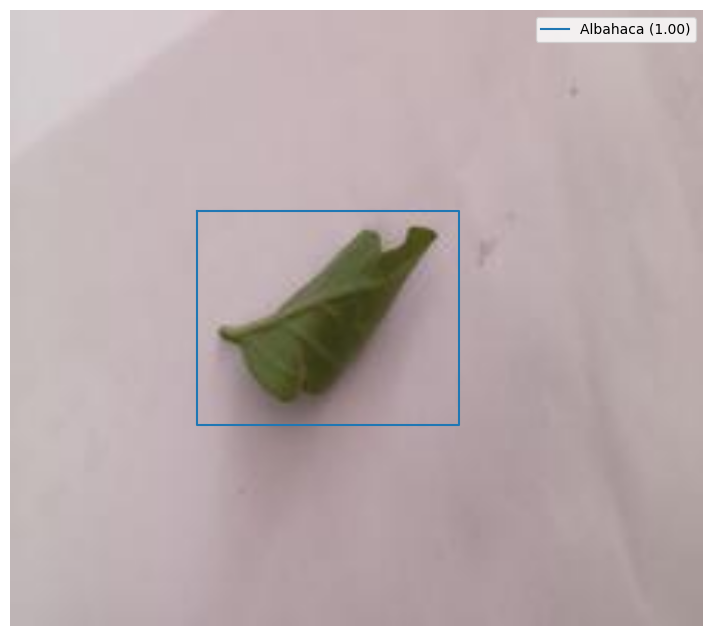

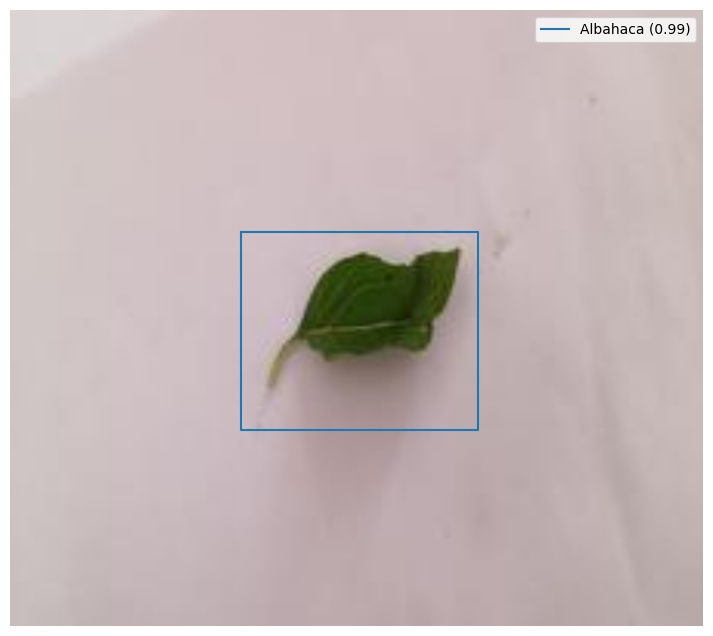

In [ ]:
import cv2
import torch
import onnxruntime as ort
import matplotlib.pyplot as plt
import os
from glob import glob

# Dictionary for class names
class_names = {
    0: "Albahaca",
    1: "Hinojo",
    2: "Malva",
    3: "Rucula",
    4: "Tomillo"
}

def test_onnx_model(onnx_path, test_image_path):
    # Crear sesión ONNX Runtime
    session = ort.InferenceSession(onnx_path)

    # Cargar y preparar imagen de prueba
    im_test = cv2.imread(test_image_path)
    im_test = cv2.resize(im_test, (900, 800))  # Mismo tamaño que en exportación
    im_test_torch = torch.as_tensor(im_test.astype("float32").transpose(2, 0, 1))
    im_test_numpy = im_test_torch.detach().numpy()

    # Ejecutar inferencia
    outputs = session.run(None, {"image": im_test_numpy})

    # Access the outputs by index
    boxes = outputs[0]
    classes = outputs[1]
    scores = outputs[2]

    # Visualizar resultados
    plt.figure(figsize=(12, 8))
    plt.imshow(cv2.cvtColor(im_test, cv2.COLOR_BGR2RGB))

    # Dibujar cajas para todas las clases con score > 0.5
    for box, class_id, score in zip(boxes, classes, scores):
        if score > 0.5:  # Umbral de confianza
            x1, y1, x2, y2 = box
            plant_name = class_names.get(int(class_id), "Desconocido")  # Obtener nombre de la planta
            plt.plot([x1, x2, x2, x1, x1], [y1, y1, y2, y2, y1],
                     label=f'{plant_name} ({score:.2f})')

    plt.legend()
    plt.axis('off')
    plt.show()

# Test the function on images from each folder in the dataset
def test_images_in_folder(folder_path, onnx_model_path):
    # Get all image paths in the folder
    image_paths = glob(os.path.join(folder_path, "*.jpg"))
    # Take the first five images
    image_paths = image_paths[:5]

    for image_path in image_paths:
        test_onnx_model(onnx_model_path, image_path)

# Example usage
folder_path = '/content/drive/MyDrive/INTELIGENCIA_ARTIFICIAL_SIS421/mmlab/Hojas_Dataset/train/albahaca'
onnx_model_path = '/content/drive/MyDrive/modelo_hojas.onnx'

# Test images from the 'albahaca' folder
test_images_in_folder(folder_path, onnx_model_path)


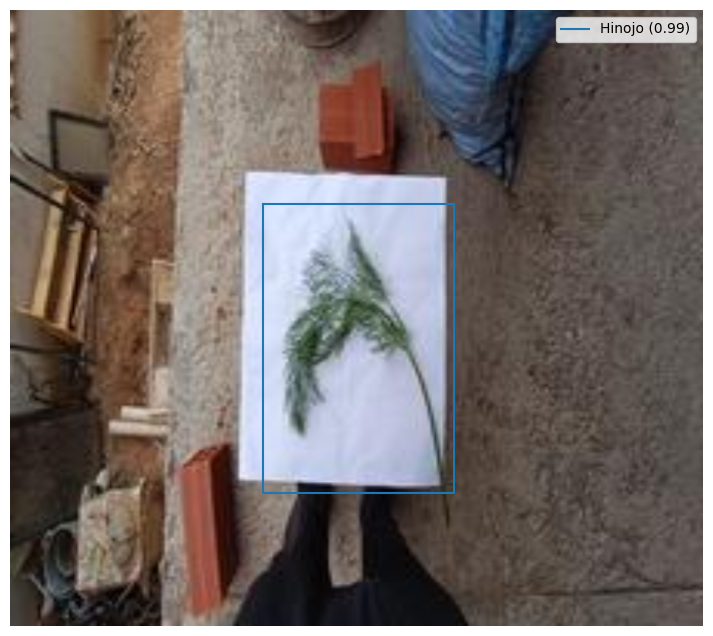

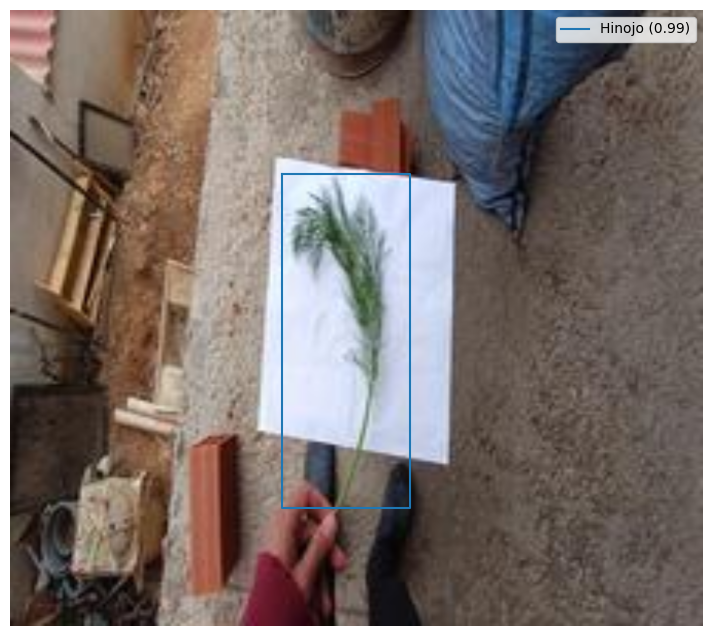

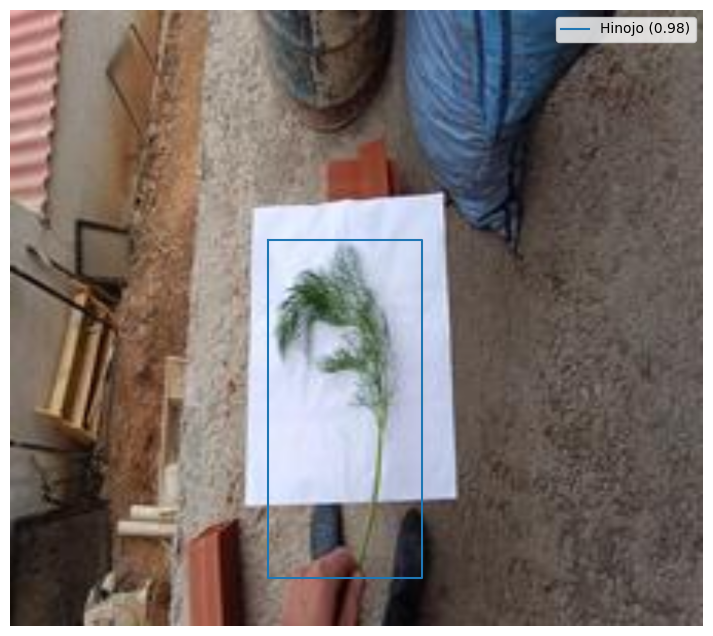

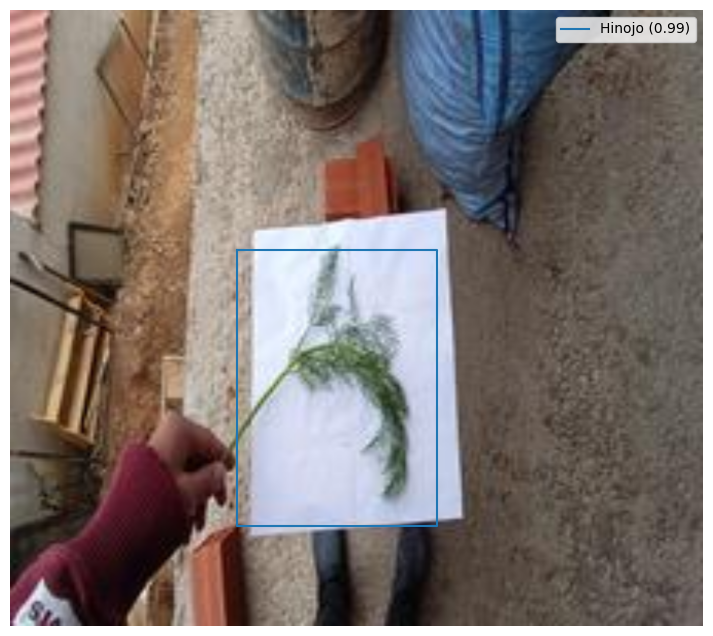

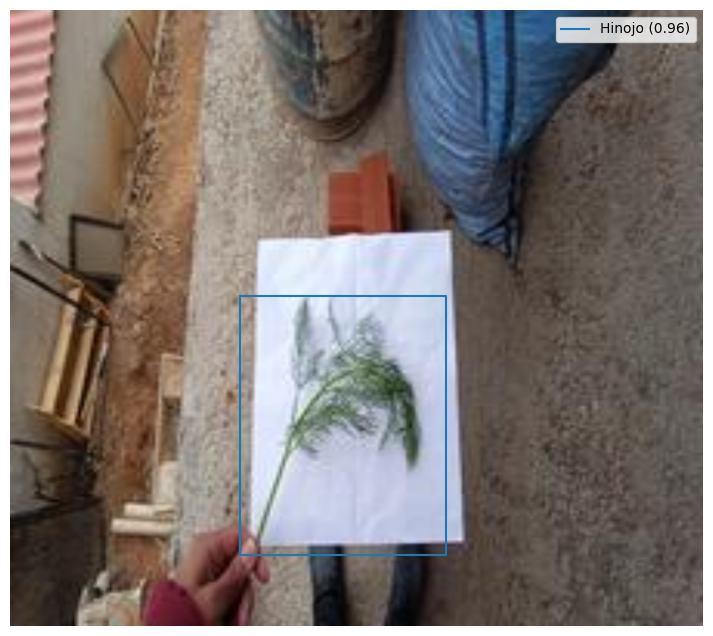

In [ ]:
import cv2
import torch
import onnxruntime as ort
import matplotlib.pyplot as plt
import os
from glob import glob

# Dictionary for class names
class_names = {
    0: "Albahaca",
    1: "Hinojo",
    2: "Malva",
    3: "Rucula",
    4: "Tomillo"
}

def test_onnx_model(onnx_path, test_image_path):
    # Crear sesión ONNX Runtime
    session = ort.InferenceSession(onnx_path)

    # Cargar y preparar imagen de prueba
    im_test = cv2.imread(test_image_path)
    im_test = cv2.resize(im_test, (900, 800))  # Mismo tamaño que en exportación
    im_test_torch = torch.as_tensor(im_test.astype("float32").transpose(2, 0, 1))
    im_test_numpy = im_test_torch.detach().numpy()

    # Ejecutar inferencia
    outputs = session.run(None, {"image": im_test_numpy})

    # Access the outputs by index
    boxes = outputs[0]
    classes = outputs[1]
    scores = outputs[2]

    # Visualizar resultados
    plt.figure(figsize=(12, 8))
    plt.imshow(cv2.cvtColor(im_test, cv2.COLOR_BGR2RGB))

    # Dibujar cajas para todas las clases con score > 0.5
    for box, class_id, score in zip(boxes, classes, scores):
        if score > 0.5:  # Umbral de confianza
            x1, y1, x2, y2 = box
            plant_name = class_names.get(int(class_id), "Desconocido")  # Obtener nombre de la planta
            plt.plot([x1, x2, x2, x1, x1], [y1, y1, y2, y2, y1],
                     label=f'{plant_name} ({score:.2f})')

    plt.legend()
    plt.axis('off')
    plt.show()

# Test the function on images from each folder in the dataset
def test_images_in_folder(folder_path, onnx_model_path):
    # Get all image paths in the folder
    image_paths = glob(os.path.join(folder_path, "*.jpg"))
    # Take the first five images
    image_paths = image_paths[:5]

    for image_path in image_paths:
        test_onnx_model(onnx_model_path, image_path)

# Example usage
folder_path = '/content/drive/MyDrive/INTELIGENCIA_ARTIFICIAL_SIS421/mmlab/Hojas_Dataset/train/hinojo'
onnx_model_path = '/content/drive/MyDrive/modelo_hojas.onnx'

# Test images from the 'albahaca' folder
test_images_in_folder(folder_path, onnx_model_path)


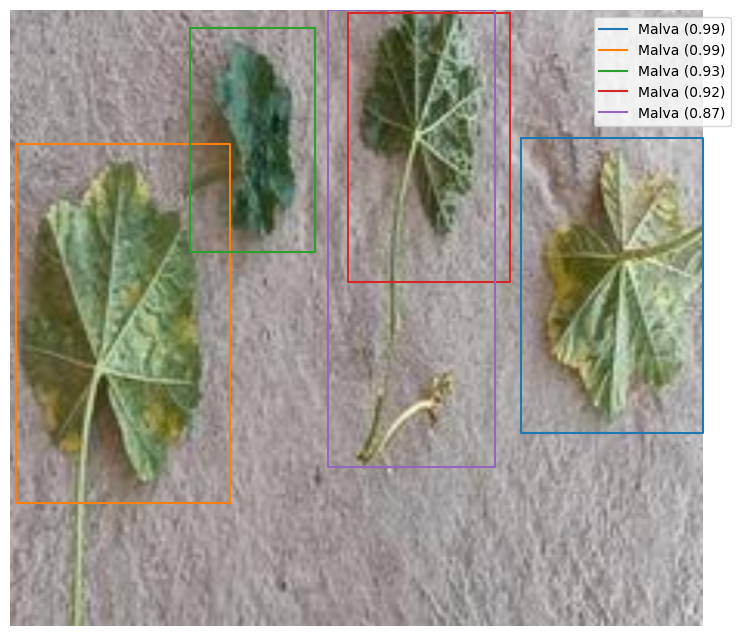

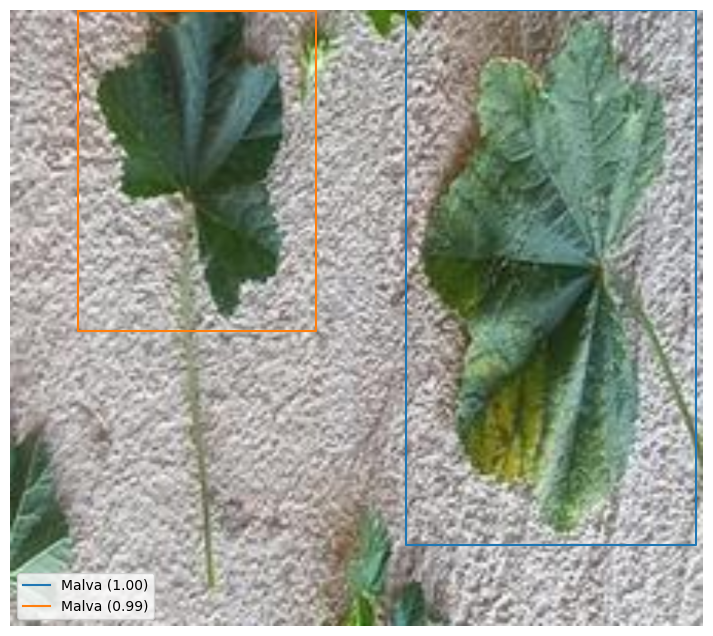

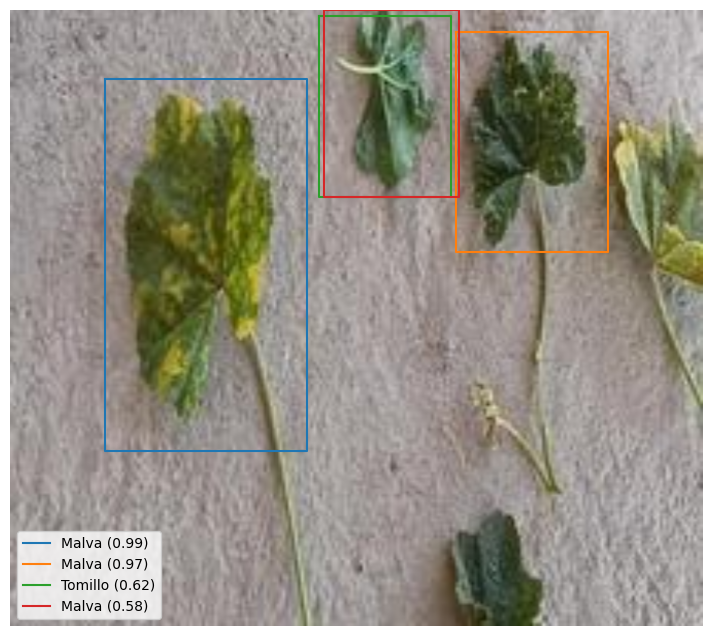

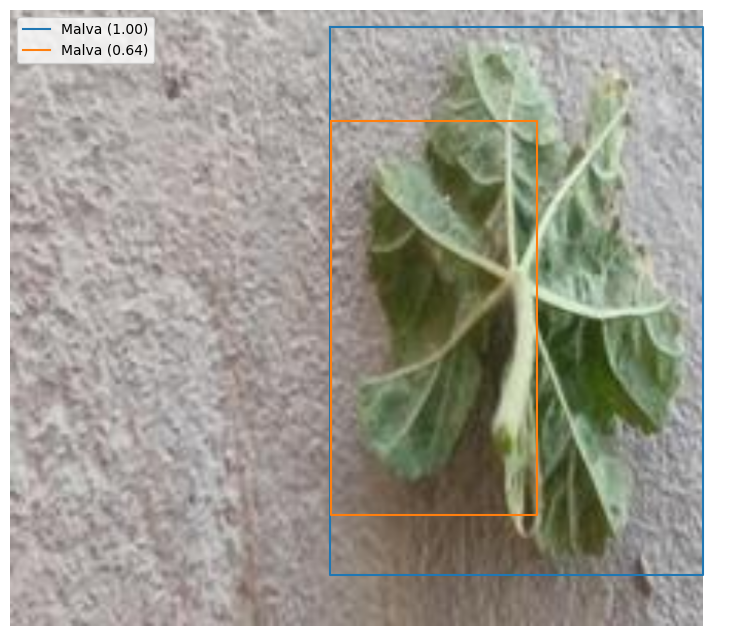

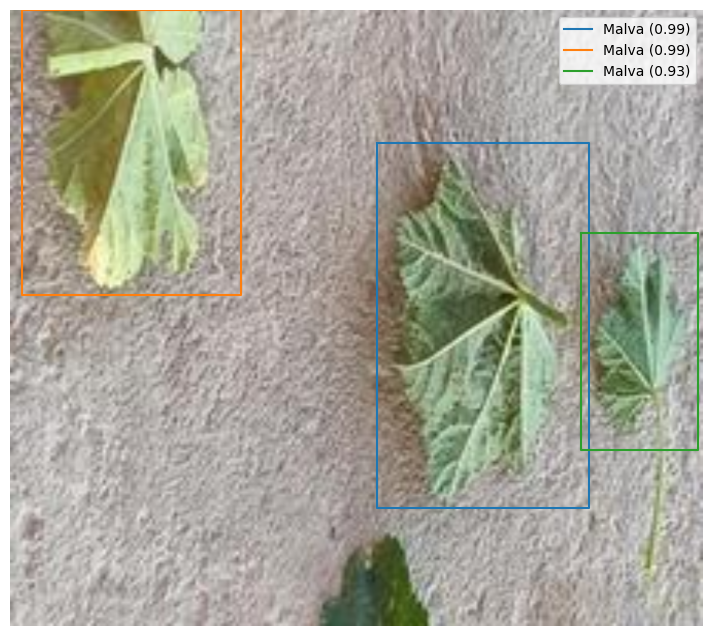

In [ ]:
import cv2
import torch
import onnxruntime as ort
import matplotlib.pyplot as plt
import os
from glob import glob

# Dictionary for class names
class_names = {
    0: "Albahaca",
    1: "Hinojo",
    2: "Malva",
    3: "Rucula",
    4: "Tomillo"
}

def test_onnx_model(onnx_path, test_image_path):
    # Crear sesión ONNX Runtime
    session = ort.InferenceSession(onnx_path)

    # Cargar y preparar imagen de prueba
    im_test = cv2.imread(test_image_path)
    im_test = cv2.resize(im_test, (900, 800))  # Mismo tamaño que en exportación
    im_test_torch = torch.as_tensor(im_test.astype("float32").transpose(2, 0, 1))
    im_test_numpy = im_test_torch.detach().numpy()

    # Ejecutar inferencia
    outputs = session.run(None, {"image": im_test_numpy})

    # Access the outputs by index
    boxes = outputs[0]
    classes = outputs[1]
    scores = outputs[2]

    # Visualizar resultados
    plt.figure(figsize=(12, 8))
    plt.imshow(cv2.cvtColor(im_test, cv2.COLOR_BGR2RGB))

    # Dibujar cajas para todas las clases con score > 0.5
    for box, class_id, score in zip(boxes, classes, scores):
        if score > 0.5:  # Umbral de confianza
            x1, y1, x2, y2 = box
            plant_name = class_names.get(int(class_id), "Desconocido")  # Obtener nombre de la planta
            plt.plot([x1, x2, x2, x1, x1], [y1, y1, y2, y2, y1],
                     label=f'{plant_name} ({score:.2f})')

    plt.legend()
    plt.axis('off')
    plt.show()

# Test the function on images from each folder in the dataset
def test_images_in_folder(folder_path, onnx_model_path):
    # Get all image paths in the folder
    image_paths = glob(os.path.join(folder_path, "*.jpg"))
    # Take the first five images
    image_paths = image_paths[:5]

    for image_path in image_paths:
        test_onnx_model(onnx_model_path, image_path)

# Example usage
folder_path = '/content/drive/MyDrive/INTELIGENCIA_ARTIFICIAL_SIS421/mmlab/Hojas_Dataset/train/malva'
onnx_model_path = '/content/drive/MyDrive/modelo_hojas.onnx'

# Test images from the 'albahaca' folder
test_images_in_folder(folder_path, onnx_model_path)


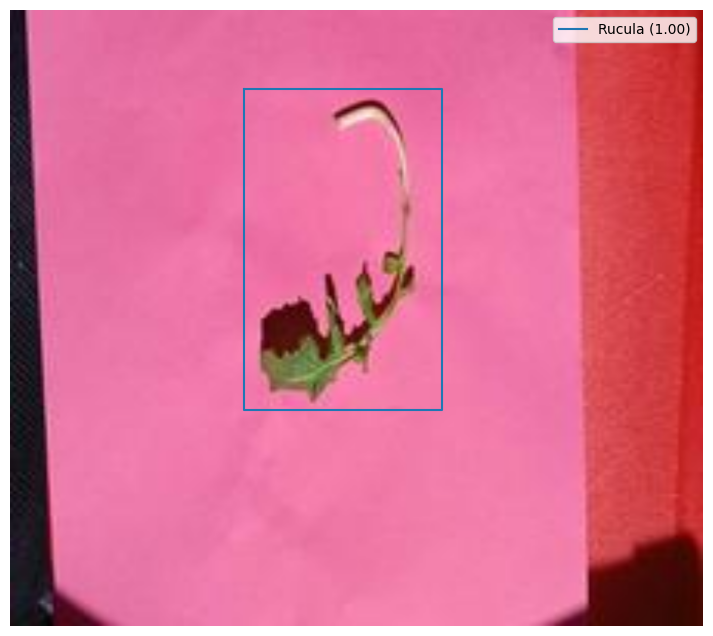

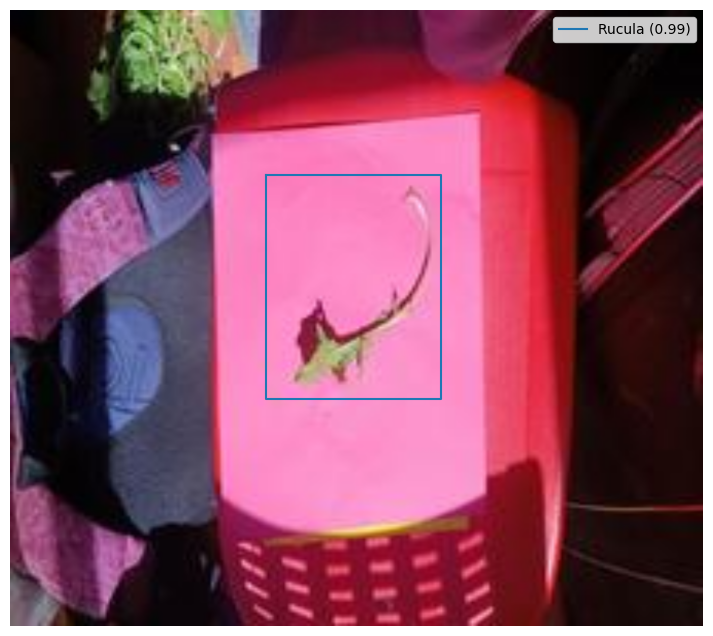

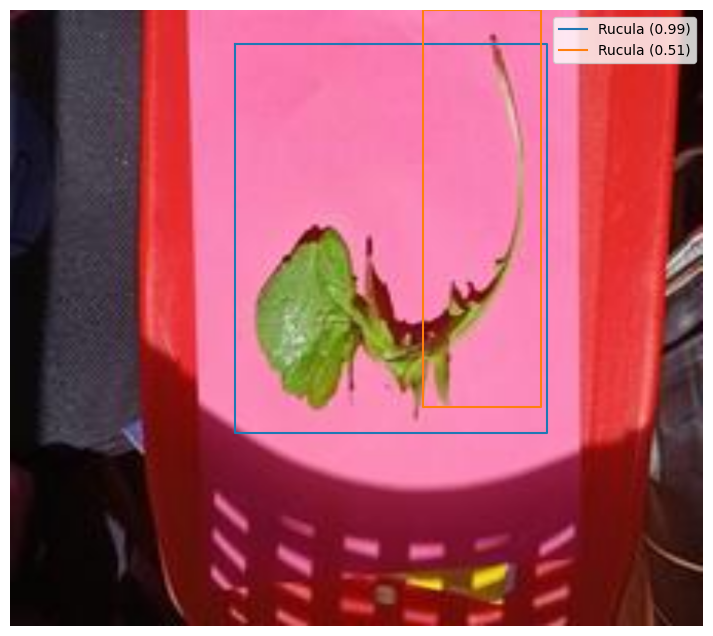

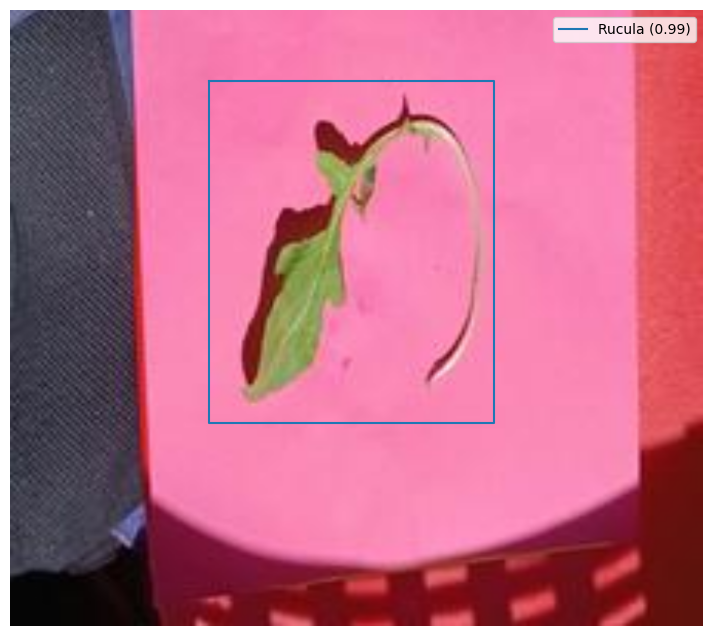

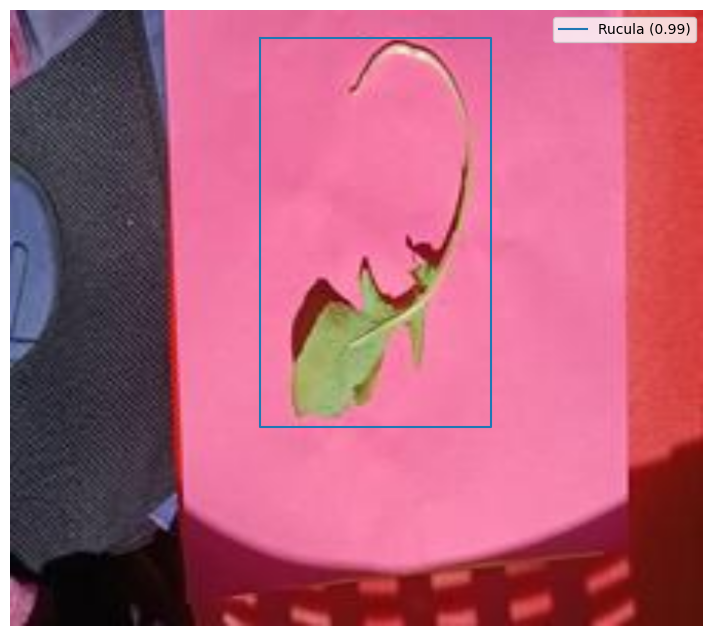

In [ ]:
import cv2
import torch
import onnxruntime as ort
import matplotlib.pyplot as plt
import os
from glob import glob

# Dictionary for class names
class_names = {
    0: "Albahaca",
    1: "Hinojo",
    2: "Malva",
    3: "Rucula",
    4: "Tomillo"
}

def test_onnx_model(onnx_path, test_image_path):
    # Crear sesión ONNX Runtime
    session = ort.InferenceSession(onnx_path)

    # Cargar y preparar imagen de prueba
    im_test = cv2.imread(test_image_path)
    im_test = cv2.resize(im_test, (900, 800))  # Mismo tamaño que en exportación
    im_test_torch = torch.as_tensor(im_test.astype("float32").transpose(2, 0, 1))
    im_test_numpy = im_test_torch.detach().numpy()

    # Ejecutar inferencia
    outputs = session.run(None, {"image": im_test_numpy})

    # Access the outputs by index
    boxes = outputs[0]
    classes = outputs[1]
    scores = outputs[2]

    # Visualizar resultados
    plt.figure(figsize=(12, 8))
    plt.imshow(cv2.cvtColor(im_test, cv2.COLOR_BGR2RGB))

    # Dibujar cajas para todas las clases con score > 0.5
    for box, class_id, score in zip(boxes, classes, scores):
        if score > 0.5:  # Umbral de confianza
            x1, y1, x2, y2 = box
            plant_name = class_names.get(int(class_id), "Desconocido")  # Obtener nombre de la planta
            plt.plot([x1, x2, x2, x1, x1], [y1, y1, y2, y2, y1],
                     label=f'{plant_name} ({score:.2f})')

    plt.legend()
    plt.axis('off')
    plt.show()

# Test the function on images from each folder in the dataset
def test_images_in_folder(folder_path, onnx_model_path):
    # Get all image paths in the folder
    image_paths = glob(os.path.join(folder_path, "*.jpg"))
    # Take the first five images
    image_paths = image_paths[:5]

    for image_path in image_paths:
        test_onnx_model(onnx_model_path, image_path)

# Example usage
folder_path = '/content/drive/MyDrive/INTELIGENCIA_ARTIFICIAL_SIS421/mmlab/Hojas_Dataset/train/rucula'
onnx_model_path = '/content/drive/MyDrive/modelo_hojas.onnx'

# Test images from the 'albahaca' folder
test_images_in_folder(folder_path, onnx_model_path)


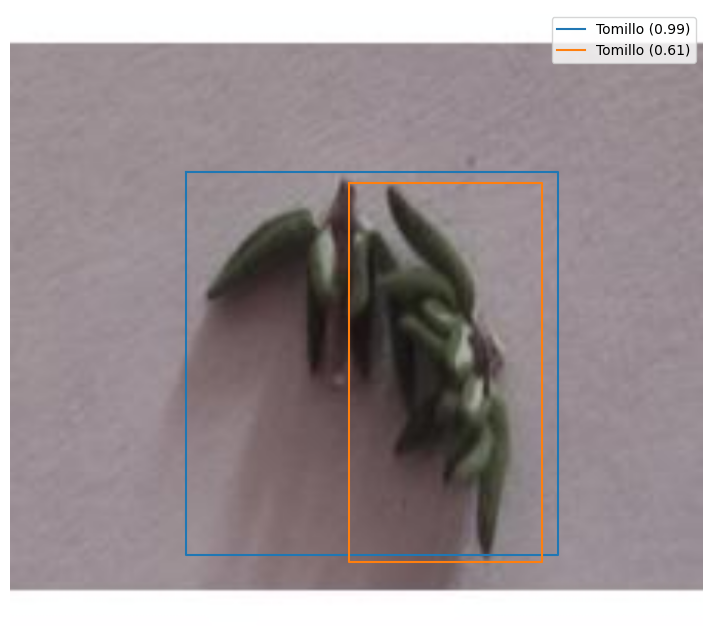

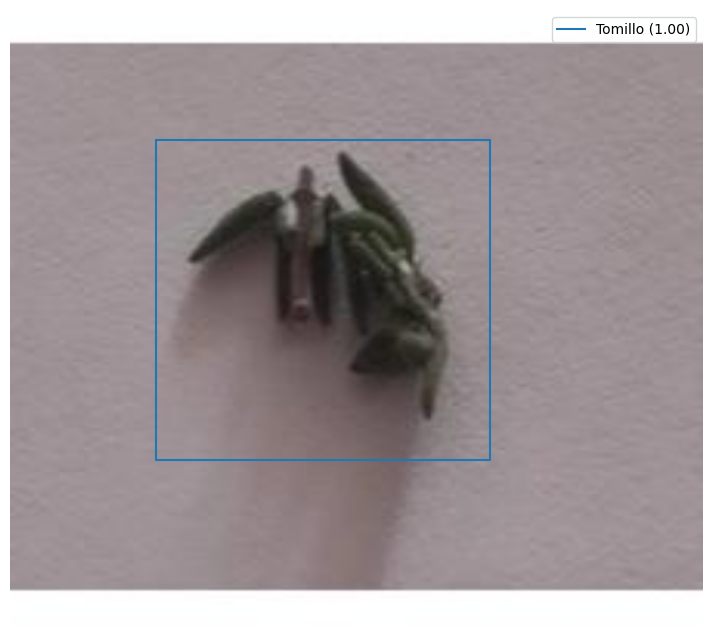

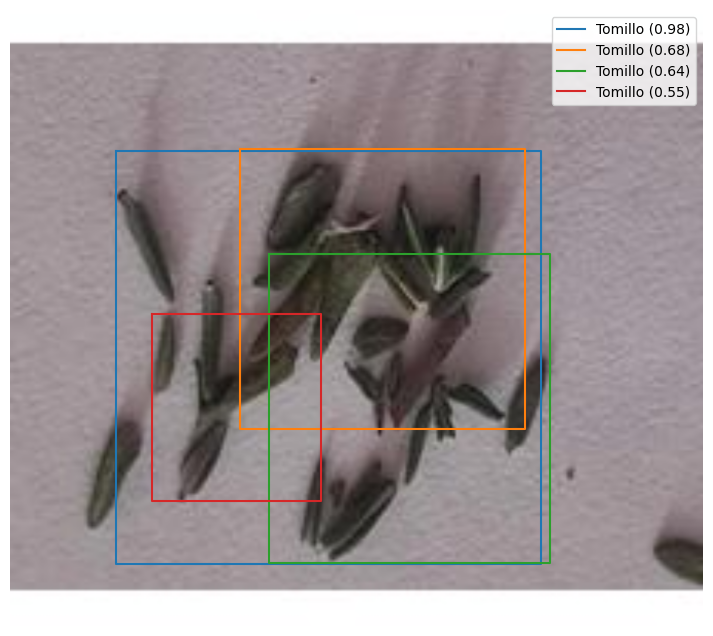

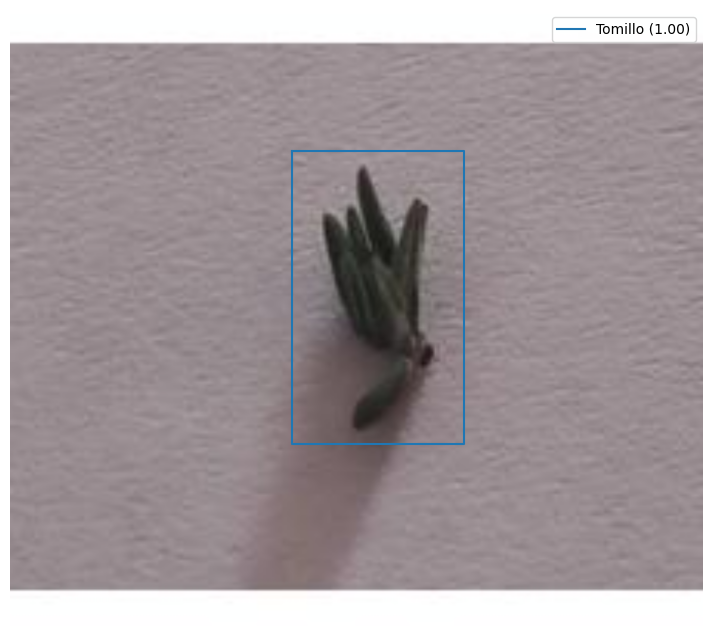

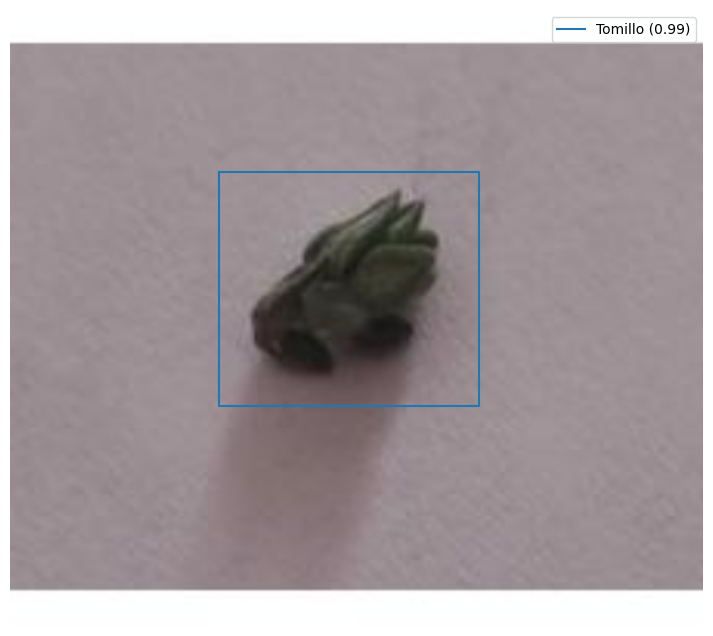

In [ ]:
import cv2
import torch
import onnxruntime as ort
import matplotlib.pyplot as plt
import os
from glob import glob

# Dictionary for class names
class_names = {
    0: "Albahaca",
    1: "Hinojo",
    2: "Malva",
    3: "Rucula",
    4: "Tomillo"
}

def test_onnx_model(onnx_path, test_image_path):
    # Crear sesión ONNX Runtime
    session = ort.InferenceSession(onnx_path)

    # Cargar y preparar imagen de prueba
    im_test = cv2.imread(test_image_path)
    im_test = cv2.resize(im_test, (900, 800))  # Mismo tamaño que en exportación
    im_test_torch = torch.as_tensor(im_test.astype("float32").transpose(2, 0, 1))
    im_test_numpy = im_test_torch.detach().numpy()

    # Ejecutar inferencia
    outputs = session.run(None, {"image": im_test_numpy})

    # Access the outputs by index
    boxes = outputs[0]
    classes = outputs[1]
    scores = outputs[2]

    # Visualizar resultados
    plt.figure(figsize=(12, 8))
    plt.imshow(cv2.cvtColor(im_test, cv2.COLOR_BGR2RGB))

    # Dibujar cajas para todas las clases con score > 0.5
    for box, class_id, score in zip(boxes, classes, scores):
        if score > 0.5:  # Umbral de confianza
            x1, y1, x2, y2 = box
            plant_name = class_names.get(int(class_id), "Desconocido")  # Obtener nombre de la planta
            plt.plot([x1, x2, x2, x1, x1], [y1, y1, y2, y2, y1],
                     label=f'{plant_name} ({score:.2f})')

    plt.legend()
    plt.axis('off')
    plt.show()

# Test the function on images from each folder in the dataset
def test_images_in_folder(folder_path, onnx_model_path):
    # Get all image paths in the folder
    image_paths = glob(os.path.join(folder_path, "*.jpg"))
    # Take the first five images
    image_paths = image_paths[:5]

    for image_path in image_paths:
        test_onnx_model(onnx_model_path, image_path)

# Example usage
folder_path = '/content/drive/MyDrive/INTELIGENCIA_ARTIFICIAL_SIS421/mmlab/Hojas_Dataset/train/tomillo'
onnx_model_path = '/content/drive/MyDrive/modelo_hojas.onnx'

# Test images from the 'albahaca' folder
test_images_in_folder(folder_path, onnx_model_path)
